## 1- mount drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Use GPU

In [ ]:
# import tensorflow as tf
# if len(tf.config.list_physical_devices('GPU')) > 0:
#   !nvidia-smi --query-gpu=gpu_name,driver_version,memory.total --format=csv

# 2- import libraries

In [ ]:
from zipfile import ZipFile
import numpy as np
from skimage.io import imread_collection
import sklearn
import tensorflow as tf
from tensorflow.keras.utils import to_categorical
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.preprocessing.image import load_img, img_to_array 
from tensorflow.keras.models import Model
from tensorflow import keras
import random
from sklearn.metrics import classification_report
from sklearn.preprocessing import StandardScaler
from keras.preprocessing.image import ImageDataGenerator #image data 
from numpy import expand_dims
import cv2
from PIL import Image
from sklearn.utils import shuffle
from sklearn.metrics import classification_report
scaler = StandardScaler()
%matplotlib inline
random.seed(30)

# 3- read data

In [ ]:
# specifying the zip file name
# file_name = "/content/drive/MyDrive/Grapevine_Leaves_Image_Dataset.zip"
file_name = "/content/drive/MyDrive/Grapevine_Leaves_Image_Dataset.zip"

# opening the zip file in READ mode
with ZipFile(file_name, 'r') as zip:
    # printing all the contents of the zip file
    zip.printdir()
  
    # extracting all the files
    print('Extracting all the files now...')
    zip.extractall()
    print('Done!')

File Name                                             Modified             Size
Grapevine_Leaves_Image_Dataset/                2022-02-11 17:53:56            0
Grapevine_Leaves_Image_Dataset/Ak/             2022-02-11 17:35:28            0
Grapevine_Leaves_Image_Dataset/Ak/Ak (1).png   2022-02-09 18:22:08        82409
Grapevine_Leaves_Image_Dataset/Ak/Ak (10).png  2022-02-09 18:22:08       120623
Grapevine_Leaves_Image_Dataset/Ak/Ak (100).png 2022-02-09 18:22:08       204438
Grapevine_Leaves_Image_Dataset/Ak/Ak (11).png  2022-02-09 18:22:08       320960
Grapevine_Leaves_Image_Dataset/Ak/Ak (12).png  2022-02-09 18:22:08       113495
Grapevine_Leaves_Image_Dataset/Ak/Ak (13).png  2022-02-09 18:22:08       283302
Grapevine_Leaves_Image_Dataset/Ak/Ak (14).png  2022-02-09 18:22:08       111328
Grapevine_Leaves_Image_Dataset/Ak/Ak (15).png  2022-02-09 18:22:08       230239
Grapevine_Leaves_Image_Dataset/Ak/Ak (16).png  2022-02-09 18:22:08       175107
Grapevine_Leaves_Image_Dataset/Ak/Ak (17

In [ ]:
path1 = '/content/Grapevine_Leaves_Image_Dataset/Ak/*.png'
path2 = '/content/Grapevine_Leaves_Image_Dataset/Ala_Idris/*.png'
path3 = '/content/Grapevine_Leaves_Image_Dataset/Buzgulu/*.png'
path4 = '/content/Grapevine_Leaves_Image_Dataset/Dimnit/*.png'
path5 = '/content/Grapevine_Leaves_Image_Dataset/Nazli/*.png'

#creating a collection with the available images
col1 = imread_collection(path1)
col2 = imread_collection(path2)
col3 = imread_collection(path3)
col4 = imread_collection(path4)
col5 = imread_collection(path5)

In [ ]:
print('class Ak = ',np.shape(col1))
print('class Ala_Idris = ',np.shape(col1))
print('class Buzgulu = ',np.shape(col1))
print('class Dimnit = ',np.shape(col1))
print('class Nazli = ',np.shape(col1))

class Ak =  (100, 511, 511, 4)
class Ala_Idris =  (100, 511, 511, 4)
class Buzgulu =  (100, 511, 511, 4)
class Dimnit =  (100, 511, 511, 4)
class Nazli =  (100, 511, 511, 4)


In [ ]:
def img_is_color(img):
    if len(img.shape) == 3:
        # Check the color channels to see if they're all the same.
        c1, c2, c3 = img[:, : , 0], img[:, :, 1], img[:, :, 2]
        if (c1 == c2).all() and (c2 == c3).all():
            return True
    return False

def show_image_list(list_images, list_titles=None, list_cmaps=None, grid=True, num_cols=2, figsize=(20, 10), title_fontsize=30):
    assert isinstance(list_images, list)
    assert len(list_images) > 0
    assert isinstance(list_images[0], np.ndarray)
    if list_titles is not None:
        assert isinstance(list_titles, list)
        assert len(list_images) == len(list_titles), '%d imgs != %d titles' % (len(list_images), len(list_titles))
    if list_cmaps is not None:
        assert isinstance(list_cmaps, list)
        assert len(list_images) == len(list_cmaps), '%d imgs != %d cmaps' % (len(list_images), len(list_cmaps))
    num_images  = len(list_images)
    num_cols    = min(num_images, num_cols)
    num_rows    = int(num_images / num_cols) + (1 if num_images % num_cols != 0 else 0)
    # Create a grid of subplots.
    fig, axes = plt.subplots(num_rows, num_cols, figsize=figsize)
    # Create list of axes for easy iteration.
    if isinstance(axes, np.ndarray):
        list_axes = list(axes.flat)
    else:
        list_axes = [axes]
    for i in range(num_images):
        img    = list_images[i]
        title  = list_titles[i] if list_titles is not None else 'Image %d' % (i)
        cmap   = list_cmaps[i] if list_cmaps is not None else (None if img_is_color(img) else 'gray')  
        list_axes[i].imshow(img, cmap=cmap)
        list_axes[i].set_title(title, fontsize=title_fontsize) 
        list_axes[i].grid(grid)
    for i in range(num_images, len(list_axes)):
        list_axes[i].set_visible(False)
    fig.tight_layout()
    _ = plt.show()

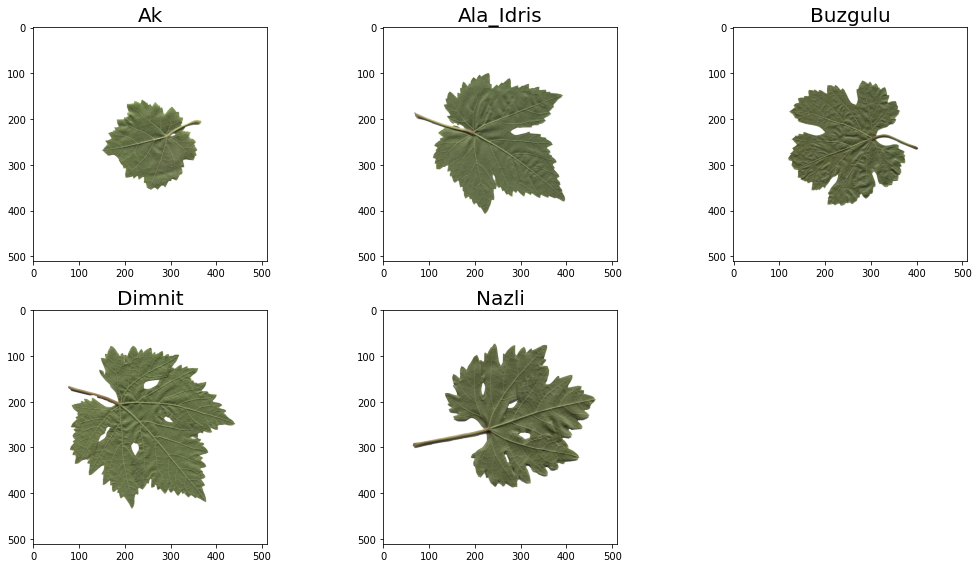

In [ ]:
show_image_list(list_images=[col1[0], col2[1], col3[2], col4[3], col5[4]], 
                list_titles=['Ak', 'Ala_Idris', 'Buzgulu', 'Dimnit', 'Nazli'],
                num_cols=3,
                figsize=(15, 8),
                grid=False,
                title_fontsize=20)

# 4- Make dataset of all datas

In [ ]:
labels1 = [0] * len(col1)
labels2 = [1] * len(col2)
labels3 = [2] * len(col3)
labels4 = [3] * len(col4)
labels5 = [4] * len(col5)
Y = labels1 + labels2 + labels3 + labels4 +labels5
XX = []
# X.append(list(col1))
XX = list(col1) + list(col2) + list(col3) +list(col4) + list(col5)
print (len(Y),len(XX))

500 500


In [ ]:
XX = np.array(XX)
Y = np.array(Y)
print(np.shape(XX))
print(np.shape(Y))

(500, 511, 511, 4)
(500,)


In [ ]:
Y

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3,

# 5- resize images

In [ ]:
X = np.zeros((500,153,153,4))
for i in range (500):
    data = XX[i]
    width, height = int(data.shape[1]*0.3), int(data.shape[0]*0.3)
    resized_data = cv2.resize(data, 
                            (width, height), 
                            interpolation = cv2.INTER_AREA,)
    X[i,:,:,:] = resized_data

In [ ]:
type(X[0,0,0,0])

numpy.float64

In [ ]:
def convert(img, target_type_min, target_type_max, target_type):
    imin = img.min()
    imax = img.max()

    a = (target_type_max - target_type_min) / (imax - imin)
    b = target_type_max - a * imax
    new_img = (a * img + b).astype(target_type)
    return new_img
X = convert(X, 0, 255, np.uint8)

In [ ]:
type(X[0,0,0,0])

numpy.uint8

In [ ]:
print(np.shape(X))
print(np.shape(Y))

(500, 153, 153, 4)
(500,)


(511, 511, 4)


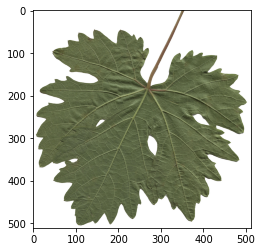

In [ ]:
print(np.shape(XX[499,:,:,:]))
plt.imshow(XX[499,:,:,:])

(153, 153, 4)


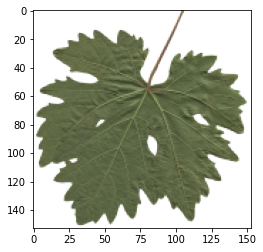

In [ ]:
print(np.shape(X[499,:,:,:]))
plt.imshow(X[499,:,:,:])

# 6- pick only 3 channels of all images

In [ ]:
X = X[:,:,:,0:3]
Y = Y

(153, 153, 3)


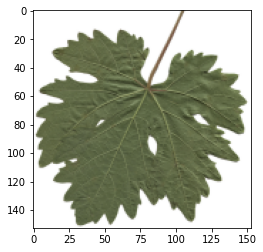

In [ ]:
print(np.shape(X[499,:,:,:]))
plt.imshow(X[499,:,:,:])

(153, 153, 3)


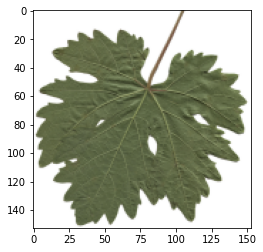

In [ ]:
print(np.shape(X[499,:,:,:]))
plt.imshow(X[499,:,:,:])

# Model1) CNN without Data Augmentation

## randomly shuffle and make train and valid dataset

In [ ]:
#randomly the data
new_x_train, new_y_train = shuffle(X, Y)
len(new_x_train),len(new_y_train)

(500, 500)

In [ ]:
# new_Y = to_categorical(new_y_train)
x_trainn, x_test, y_trainn, y_test= train_test_split(new_x_train, new_y_train, test_size=0.2, random_state=42)
x_train, x_val, y_train, y_val= train_test_split(x_trainn,y_trainn, test_size=0.2, random_state=42)
print('x_train=',np.shape(x_train))
print('y_train=',np.shape(y_train))
print('x_val=',np.shape(x_val))
print('y_val=',np.shape(y_val))
print('x_test=',np.shape(x_test))
print('y_test=',np.shape(y_test))

x_train= (320, 153, 153, 3)
y_train= (320,)
x_val= (80, 153, 153, 3)
y_val= (80,)
x_test= (100, 153, 153, 3)
y_test= (100,)


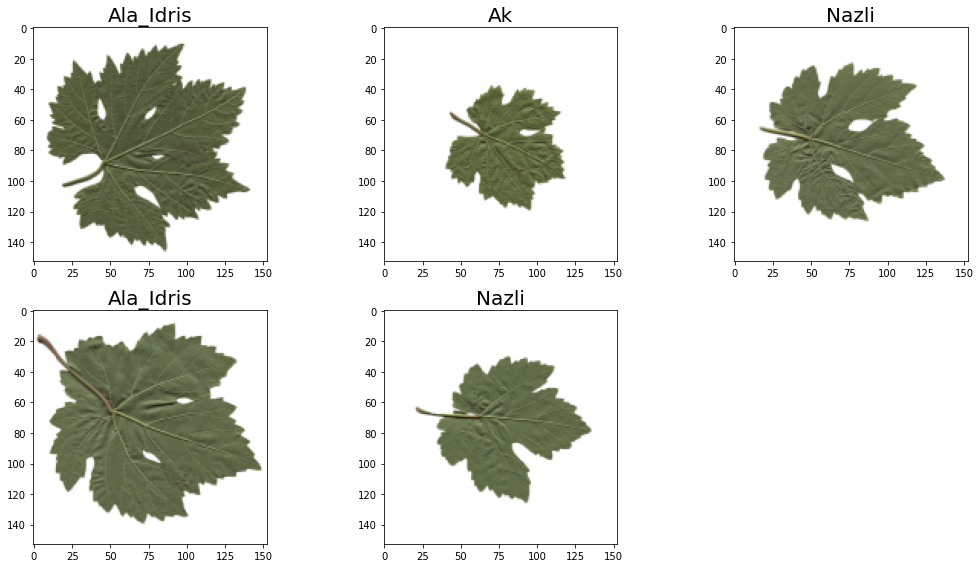

In [ ]:
show_image_list(list_images=[new_x_train[0], new_x_train[1], new_x_train[2], new_x_train[3], new_x_train[4]], 
                list_titles=['Ala_Idris', 'Ak', 'Nazli', 'Ala_Idris', 'Nazli'],
                num_cols=3,
                figsize=(15, 8),
                grid=False,
                title_fontsize=20)

## CNN Model

In [ ]:
model1 = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), input_shape=(153, 153, 3), activation='relu', kernel_initializer='he_uniform', padding='same'),
    tf.keras.layers.BatchNormalization(),

    tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),
    tf.keras.layers.Dropout(0.5),
    
    tf.keras.layers.Flatten(),

    tf.keras.layers.Dense(512, activation='relu'), 
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dense(5, activation='softmax')
])

for layer in model1.layers:
    print(layer.output_shape)

(None, 153, 153, 32)
(None, 153, 153, 32)
(None, 153, 153, 32)
(None, 153, 153, 32)
(None, 76, 76, 32)
(None, 76, 76, 32)
(None, 184832)
(None, 512)
(None, 512)
(None, 128)
(None, 5)


Epoch 1/15


/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)
/usr/local/lib/python3.7/dist-packages/tensorflow/python/util/dispatch.py:1082: UserWarning: "`categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  return dispatch_target(*args, **kwargs)


5/5 [==============================] - 1s 160ms/step - loss: 12.6082 - accuracy: 0.1562 - val_loss: 10.5608 - val_accuracy: 0.2375
Epoch 2/15
5/5 [==============================] - 1s 115ms/step - loss: 4.8184 - accuracy: 0.2531 - val_loss: 4.1403 - val_accuracy: 0.2375
Epoch 3/15
5/5 [==============================] - 1s 118ms/step - loss: 2.8825 - accuracy: 0.2594 - val_loss: 2.7976 - val_accuracy: 0.2625
Epoch 4/15
5/5 [==============================] - 1s 116ms/step - loss: 1.9166 - accuracy: 0.2781 - val_loss: 2.5510 - val_accuracy: 0.1375
Epoch 5/15
5/5 [==============================] - 1s 116ms/step - loss: 1.6024 - accuracy: 0.3344 - val_loss: 2.5437 - val_accuracy: 0.2000
Epoch 6/15
5/5 [==============================] - 1s 123ms/step - loss: 1.4160 - accuracy: 0.4531 - val_loss: 2.4971 - val_accuracy: 0.1750
Epoch 7/15
5/5 [==============================] - 1s 114ms/step - loss: 1.2416 - accuracy: 0.4938 - val_loss: 2.4060 - val_accuracy: 0.2000
Epoch 8/15
5/5 [=============

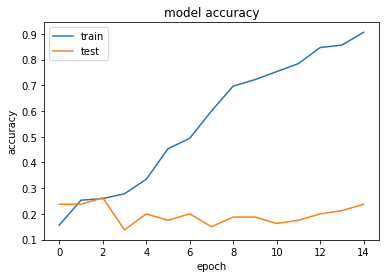

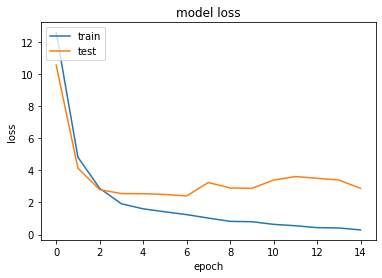

In [ ]:
# compile and train the model
model1.compile(optimizer=keras.optimizers.SGD(lr = 0.001, decay=1e-6, momentum=0.9 ,nesterov=True),
             loss = tf.keras.losses.CategoricalCrossentropy(from_logits=True),
             metrics=['accuracy'])

history = model1.fit(x_train, to_categorical(y_train), batch_size=64, epochs=15, validation_data=(x_val, to_categorical(y_val)), validation_batch_size=32,  verbose=1)

# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

## Evaluate Model

In [ ]:
prediction = model1.predict(x_test)

In [ ]:
# evaluate accuracy on test data
test_loss, test_acc = model1.evaluate(x_test, to_categorical(y_test), verbose=2)
print('\nTest accuracy:', test_acc,'Test loss:',test_loss)

4/4 - 0s - loss: 2.9555 - accuracy: 0.3200 - 89ms/epoch - 22ms/step

Test accuracy: 0.3199999928474426 Test loss: 2.955493211746216


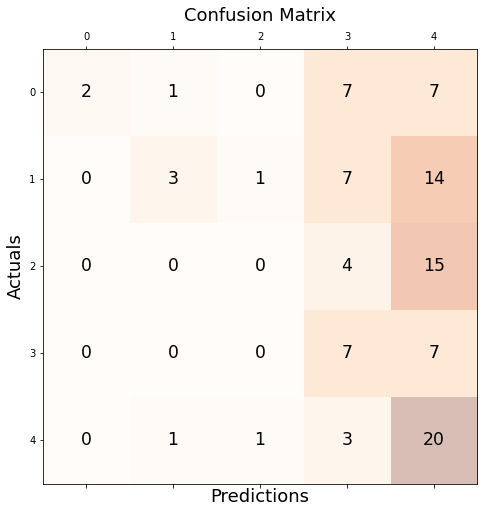

In [ ]:
y_pred_bool = np.argmax(prediction, axis=1)
y_test_bool = y_test
#from sklearn.metrics.confusion_matrix import confusion_matrix
# showing the results 
conf_matrix = sklearn.metrics.confusion_matrix(y_pred=y_pred_bool , y_true=y_test_bool)
fig, ax = plt.subplots(figsize=(8, 8))
ax.matshow(conf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
for i in range(conf_matrix.shape[0]):
    for j in range(conf_matrix.shape[1]):
        ax.text(x=j, y=i,s=conf_matrix[i, j], va='center', ha='center', size='xx-large')
 
plt.xlabel('Predictions', fontsize=18)
plt.ylabel('Actuals', fontsize=18)
plt.title('Confusion Matrix', fontsize=18)
plt.show()

In [ ]:
print(classification_report(y_test_bool, y_pred_bool))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        23
           1       0.00      0.00      0.00        22
           2       0.00      0.00      0.00        17
           3       0.00      0.00      0.00        22
           4       0.16      1.00      0.28        16

    accuracy                           0.16       100
   macro avg       0.03      0.20      0.06       100
weighted avg       0.03      0.16      0.04       100



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


# Model 2) CNN with Data Augmentation

## randomly shuffle and make train and valid dataset

In [ ]:
#randomly the data
new_x_train, new_y_train = shuffle(X, Y)
len(new_x_train),len(new_y_train)

(500, 500)

In [ ]:
x_train, x_test, y_train, y_test= train_test_split(new_x_train, new_y_train, test_size=0.2, random_state=42)
print('x_train=',np.shape(x_train))
print('y_train=',np.shape(y_train))
print('x_test=',np.shape(x_test))
print('y_test=',np.shape(y_test))

x_train= (400, 153, 153, 3)
y_train= (400,)
x_test= (100, 153, 153, 3)
y_test= (100,)


## Data Augmentation

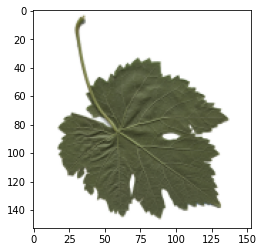

(153, 153, 3)

In [ ]:
image = x_train[0]
plt.imshow(image)
plt.show()
np.shape(image)

**Random horizontal shift**

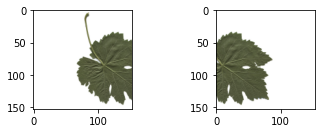

In [ ]:
#Random horizontal shift
data = img_to_array(x_train[0])
samples = expand_dims(data,0)
datagen = ImageDataGenerator(width_shift_range=[-50,50])
it = datagen.flow(samples, batch_size=1)
for i in range(2):
  plt.subplot(220 + 1+ i)
  batch = it.next()
  image1 = batch[0].astype('uint8')
  plt.imshow(image1)
plt.show()

**Vertical shift**

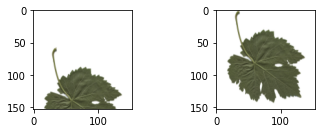

In [ ]:
#Vertical shift data = img_to_array(image)
datagen = ImageDataGenerator(height_shift_range=0.5)
it = datagen.flow(samples, batch_size=1)
for i in range(2):
  plt.subplot(220 + 1 + i)
  batch = it.next()
  image2 = batch[0].astype('uint8')
  plt.imshow(image2)
plt.show()

**Rotation**

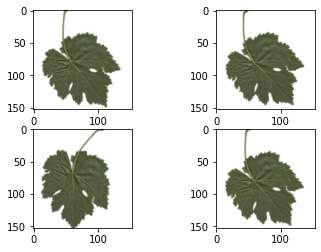

In [ ]:
#Rotation
datagen = ImageDataGenerator(rotation_range=90)  #Specify angle of rotation
it = datagen.flow(samples, batch_size=1)
for i in range(4):
  plt.subplot(220 + 1 + i)
  batch = it.next()
  image4 = batch[0].astype('uint8')
  plt.imshow(image4)
plt.show()

**brightness adjustment**

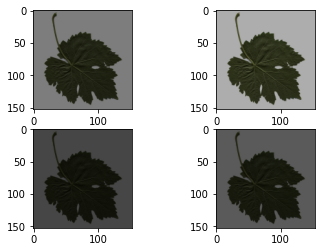

In [ ]:
#brightness adjustment
datagen = ImageDataGenerator(brightness_range=[0.1,1.0]) 
it = datagen.flow(samples, batch_size=1)
for i in range(4):
  plt.subplot(220+ 1+ i)
  batch = it.next()
  image5 = batch[0].astype('uint8')
  plt.imshow(image5)
plt.show()

**Zooming**

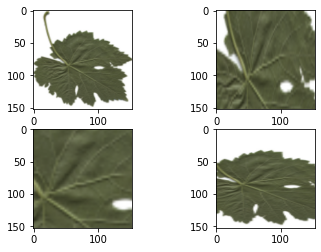

In [ ]:
#Zooming
datagen = ImageDataGenerator(zoom_range=[0.2,1.0]) 
it = datagen.flow(samples, batch_size=1)
for i in range(4):
  plt.subplot(220 + 1 + i)
  batch = it.next()
  image6 = batch[0].astype('uint8')
  plt.imshow(image6)
plt.show()

**Final Data Augmentation**

In [ ]:
from keras.applications.vgg19 import preprocess_input
new_x_train = np.zeros((2800,153,153,3))
datagen = ImageDataGenerator(width_shift_range=0.15,zoom_range=0.10, height_shift_range=0.15,shear_range=0.15, rotation_range=20,brightness_range=[0.6,1.4], horizontal_flip=True,fill_mode='nearest')
m=0
for j in range (400):
  data = img_to_array(x_train[j,:,:,:])
  for i in range(7):
    samples1 = expand_dims(data,0)
    it1 = datagen.flow(samples1, batch_size=1)
    batch1 = it1.next()
    image1 = batch1[0].astype('uint8')
    new_x_train[m,:,:,:]= batch1
    m+=1

In [ ]:
new_y_train = np.zeros((2800,1))
m=0
for j in range (400):
  data = y_train[j]
  for i in range(7):
      new_y_train[m,:] = data
      m+=1
new_x_train = convert(new_x_train, 0, 255, np.uint8)
new_y_train = to_categorical(new_y_train)

In [ ]:
print(np.shape(new_x_train))
print(np.shape(new_y_train))

(2800, 153, 153, 3)
(2800, 5)


/usr/local/lib/python3.7/dist-packages/matplotlib/text.py:1165: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if s != self._text:


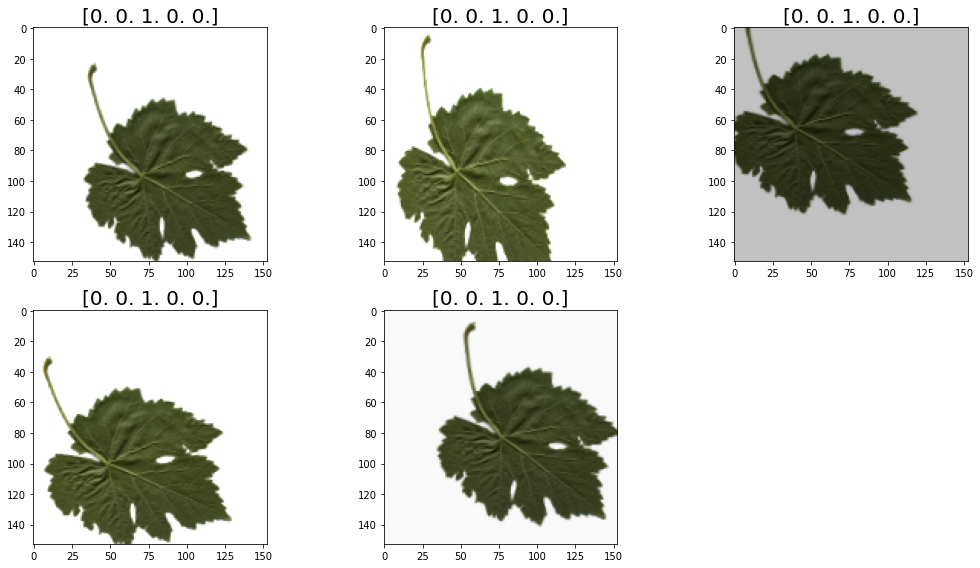

In [ ]:
label_y_0 = new_y_train[0]
label_y_1 = new_y_train[1]
label_y_2 = new_y_train[2]
label_y_3 = new_y_train[3]
label_y_4 = new_y_train[4]
show_image_list(list_images=[new_x_train[0], new_x_train[1], new_x_train[2], new_x_train[3], new_x_train[4]], 
                list_titles=[label_y_0, label_y_1, label_y_2, label_y_3, label_y_4],
                num_cols=3,
                figsize=(15, 8),
                grid=False,
                title_fontsize=20)

In [ ]:
x_train, x_val, y_train, y_val= train_test_split(new_x_train, new_y_train, test_size=0.2, random_state=42)
y_test = to_categorical(y_test)
print('x_train=',np.shape(x_train))
print('y_train=',np.shape(y_train))
print('x_val=',np.shape(x_val))
print('y_val=',np.shape(y_val))
print('x_test=',np.shape(x_test))
print('y_test=',np.shape(y_test))

x_train= (2240, 153, 153, 3)
y_train= (2240, 5)
x_val= (560, 153, 153, 3)
y_val= (560, 5)
x_test= (100, 153, 153, 3)
y_test= (100, 5)


## CNN Model

In [ ]:
model1 = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), input_shape=(153, 153, 3), activation='relu', kernel_initializer='he_uniform', padding='same'),
    tf.keras.layers.BatchNormalization(),

    tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),
    tf.keras.layers.Dropout(0.5),
    
    tf.keras.layers.Flatten(),

    tf.keras.layers.Dense(512, activation='relu'), 
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dense(5, activation='softmax')
])

for layer in model1.layers:
    print(layer.output_shape)

(None, 153, 153, 32)
(None, 153, 153, 32)
(None, 153, 153, 32)
(None, 153, 153, 32)
(None, 76, 76, 32)
(None, 76, 76, 32)
(None, 184832)
(None, 512)
(None, 512)
(None, 128)
(None, 5)


Epoch 1/15


/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)
/usr/local/lib/python3.7/dist-packages/tensorflow/python/util/dispatch.py:1082: UserWarning: "`categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  return dispatch_target(*args, **kwargs)


35/35 [==============================] - 5s 125ms/step - loss: 2.9750 - accuracy: 0.2313 - val_loss: 3.9079 - val_accuracy: 0.2036
Epoch 2/15
35/35 [==============================] - 4s 110ms/step - loss: 1.5412 - accuracy: 0.3339 - val_loss: 2.1744 - val_accuracy: 0.2036
Epoch 3/15
35/35 [==============================] - 4s 111ms/step - loss: 1.3318 - accuracy: 0.4263 - val_loss: 1.7389 - val_accuracy: 0.2625
Epoch 4/15
35/35 [==============================] - 4s 109ms/step - loss: 1.2018 - accuracy: 0.5031 - val_loss: 1.5530 - val_accuracy: 0.3125
Epoch 5/15
35/35 [==============================] - 4s 113ms/step - loss: 1.0021 - accuracy: 0.5911 - val_loss: 1.4534 - val_accuracy: 0.3821
Epoch 6/15
35/35 [==============================] - 4s 111ms/step - loss: 0.8466 - accuracy: 0.6585 - val_loss: 1.4647 - val_accuracy: 0.3679
Epoch 7/15
35/35 [==============================] - 4s 113ms/step - loss: 0.7111 - accuracy: 0.7286 - val_loss: 1.4337 - val_accuracy: 0.3857
Epoch 8/15
35/35 

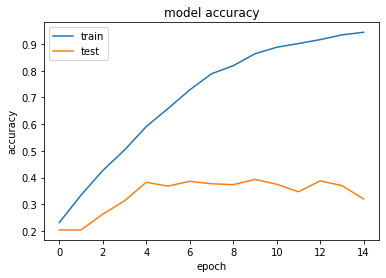

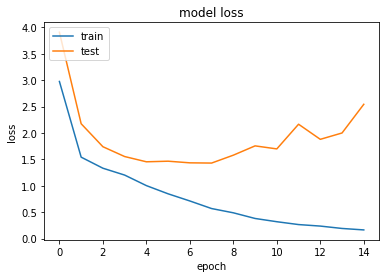

In [ ]:
# compile and train the model
model1.compile(optimizer=keras.optimizers.SGD(lr = 0.001, decay=1e-6, momentum=0.9 ,nesterov=True),
             loss = tf.keras.losses.CategoricalCrossentropy(from_logits=True),
             metrics=['accuracy'])

history = model1.fit(x_train, y_train, batch_size=64, epochs=15, validation_data=(x_val, y_val), validation_batch_size=32,  verbose=1)

# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

## Evaluate Model

In [ ]:
# evaluate accuracy on test data
test_loss, test_acc = model1.evaluate(x_test, y_test, verbose=2)
print('\nTest accuracy:', test_acc,'Test loss:',test_loss)

4/4 - 0s - loss: 1.8780 - accuracy: 0.3600 - 84ms/epoch - 21ms/step

Test accuracy: 0.36000001430511475 Test loss: 1.8780020475387573


In [ ]:
prediction = model1.predict(x_test)

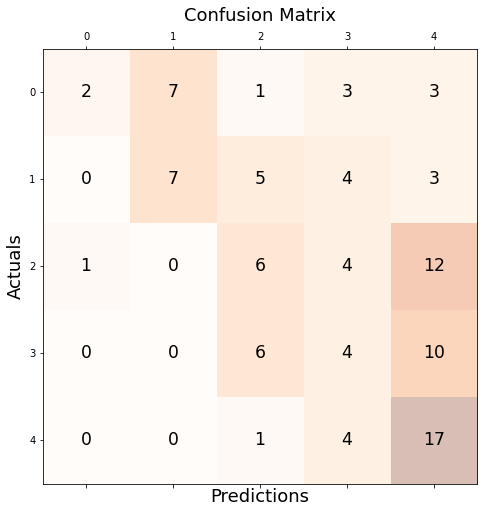

In [ ]:
y_pred_bool = np.argmax(prediction, axis=1)
y_test_bool = np.argmax(y_test, axis=1)
#from sklearn.metrics.confusion_matrix import confusion_matrix
# showing the results 
conf_matrix = sklearn.metrics.confusion_matrix(y_pred=y_pred_bool , y_true=y_test_bool)
fig, ax = plt.subplots(figsize=(8, 8))
ax.matshow(conf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
for i in range(conf_matrix.shape[0]):
    for j in range(conf_matrix.shape[1]):
        ax.text(x=j, y=i,s=conf_matrix[i, j], va='center', ha='center', size='xx-large')
 
plt.xlabel('Predictions', fontsize=18)
plt.ylabel('Actuals', fontsize=18)
plt.title('Confusion Matrix', fontsize=18)
plt.show()

In [ ]:
print(classification_report(y_test_bool, y_pred_bool))

              precision    recall  f1-score   support

           0       0.67      0.12      0.21        16
           1       0.50      0.37      0.42        19
           2       0.32      0.26      0.29        23
           3       0.21      0.20      0.21        20
           4       0.38      0.77      0.51        22

    accuracy                           0.36       100
   macro avg       0.41      0.35      0.33       100
weighted avg       0.40      0.36      0.33       100



# Model 3) CNN with data augmentation By pretrained VGG19

## make model available

In [ ]:
!pip install opencv-python==4.5.5.62
!pip install opencv-contrib-python==4.5.5.62
!pip install tf-explain

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 60.4 MB 43.3 MB/s 
  Attempting uninstall: opencv-python
    Found existing installation: opencv-python 4.1.2.30
    Uninstalling opencv-python-4.1.2.30:
      Successfully uninstalled opencv-python-4.1.2.30
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 66.6 MB 100 kB/s 
  Attempting uninstall: opencv-contrib-python
    Found existing installation: opencv-contrib-python 4.1.2.30
    Uninstalling opencv-contrib-python-4.1.2.30:
      Successfully uninstalled opencv-contrib-python-4.1.2.3

In [ ]:
import os
import gc
import sys

import pandas as pd
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import skimage
from skimage.feature import hog, canny
from skimage.filters import sobel
from skimage import color

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder

from keras import layers
import keras.backend as K
from keras.models import Sequential, Model
from keras.preprocessing import image
from keras.layers import Input, Dense, Activation, Dropout
from keras.layers import Flatten, BatchNormalization
from keras.layers import Convolution2D, MaxPooling2D, AveragePooling2D, GlobalAveragePooling2D 
from keras.applications.imagenet_utils import preprocess_input
from tensorflow.keras.applications.vgg19 import VGG19
from tensorflow.keras.applications import ResNet50
from tf_explain.core.activations import ExtractActivations
from tf_explain.core.grad_cam import GradCAM
from sklearn.model_selection import train_test_split
from keras.utils.data_utils import get_file

from PIL import Image
from tqdm import tqdm
import random as rnd
import cv2
from keras.preprocessing.image import ImageDataGenerator
from numpy import expand_dims

!pip install livelossplot
from livelossplot import PlotLossesKeras

%matplotlib inline

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 793 kB 9.6 MB/s 
     |████████████████████████████████| 381 kB 40.9 MB/s 
  Attempting uninstall: prompt-toolkit
    Found existing installation: prompt-toolkit 1.0.18
    Uninstalling prompt-toolkit-1.0.18:
      Successfully uninstalled prompt-toolkit-1.0.18
  Attempting uninstall: ipython
    Found existing installation: ipython 5.5.0
    Uninstalling ipython-5.5.0:
      Successfully uninstalled ipython-5.5.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
jupyter-console 5.2.0 requires prompt-toolkit<2.0.0,>=1.0.0, but you have prompt-toolkit 3.0.30 which is incompatible.
google-colab 1.0.0 requires ipython~=5.5.0, but you have ipython 7.34.0 which is incompatible.


In [ ]:
main_path = '/content/Grapevine_Leaves_Image_Dataset/'
path_Ak = main_path + 'Ak'
path_Ala_Idris = main_path + 'Ala_Idris'
path_Buzgulu = main_path + 'Buzgulu'
path_Dimnit = main_path + 'Dimnit'
path_Nazli = main_path + 'Nazli'

In [ ]:
main_df = pd.DataFrame()

In [ ]:
main_df['images'] = os.listdir(path_Ak) + os.listdir(path_Ala_Idris) + os.listdir(path_Buzgulu) + os.listdir(path_Dimnit) + os.listdir(path_Nazli)

In [ ]:
main_df

,images
0,Ak (92).png
1,Ak (75).png
2,Ak (83).png
3,Ak (2).png
4,Ak (44).png
...,...
495,Nazli (19).png
496,Nazli (27).png
497,Nazli (9).png
498,Nazli (64).png


In [ ]:
classes = []
paths = []
for image in main_df['images']:
    class_ = image.split(' (')[0]
    classes.append(class_)
    paths.append(main_path+class_+'/'+image)

In [ ]:
main_df['classes'] = classes
main_df['path'] = paths

In [ ]:
main_df.head()

,images,classes,path
0,Ak (92).png,Ak,/content/Grapevine_Leaves_Image_Dataset/Ak/Ak ...
1,Ak (75).png,Ak,/content/Grapevine_Leaves_Image_Dataset/Ak/Ak ...
2,Ak (83).png,Ak,/content/Grapevine_Leaves_Image_Dataset/Ak/Ak ...
3,Ak (2).png,Ak,/content/Grapevine_Leaves_Image_Dataset/Ak/Ak ...
4,Ak (44).png,Ak,/content/Grapevine_Leaves_Image_Dataset/Ak/Ak ...


In [ ]:
main_df.isna().sum()

images     0
classes    0
path       0
dtype: int64

In [ ]:
print('Leaves Count: ',len(main_df['classes'].value_counts()))
main_df['classes'].value_counts()

Leaves Count:  5


Ak           100
Ala_Idris    100
Buzgulu      100
Dimnit       100
Nazli        100
Name: classes, dtype: int64

In [ ]:
plot = sns.countplot(x = main_df['classes'], color = '#2596be')
sns.set(rc={'figure.figsize':(15,12)})
sns.despine()
plot.set_title('Class Distribution\n', x = 0.1, y=1, fontsize = 18);
plot.set_ylabel("Count", x = 0.02, fontsize = 12)
plot.set_xlabel("Leaves classes", fontsize = 15)

for p in plot.patches:
    plot.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2, p.get_height()), 
       ha = 'center', va = 'center', xytext = (0, -20), textcoords = 'offset points', size = 15)

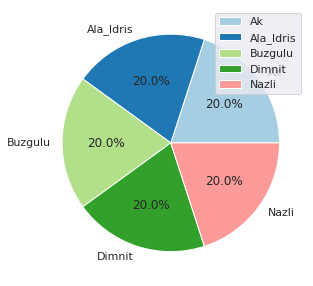

In [ ]:
plt.figure(figsize=(5,5))
class_cnt = main_df.groupby(['classes']).size().reset_index(name = 'counts')
colors = sns.color_palette('Paired')[0:9]
plt.pie(class_cnt['counts'], labels=class_cnt['classes'], colors=colors, autopct='%1.1f%%')
plt.legend(loc='upper right')
plt.show()

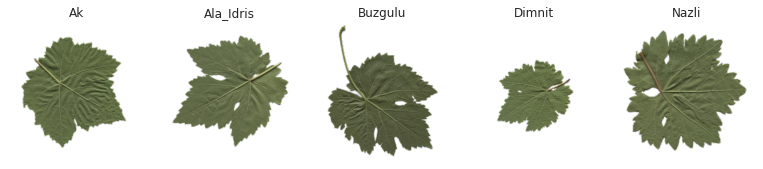

In [ ]:
plt.figure(figsize = (15,12))
for idx,i in enumerate(main_df.classes.unique()):
    plt.subplot(4,7,idx+1)
    df = main_df[main_df['classes'] ==i].reset_index(drop = True)
    image_path = df.loc[rnd.randint(0, len(df))-1,'path']
    img = Image.open(image_path)
    img = img.resize((224,224))
    plt.imshow(img)
    plt.axis('off')
    plt.title(i)
plt.tight_layout()
plt.show()

In [ ]:
def plot_species(df,leave_name):
    plt.figure(figsize = (12,12))
    species_df = df[df['classes'] == leave_name].reset_index(drop = True)
    plt.suptitle(leave_name)
    for idx,i in enumerate(np.random.choice(species_df['path'],32)):
        plt.subplot(8,8,idx+1)
        image_path = i
        img = Image.open(image_path)
        img = img.resize((224,224))
        plt.imshow(img)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

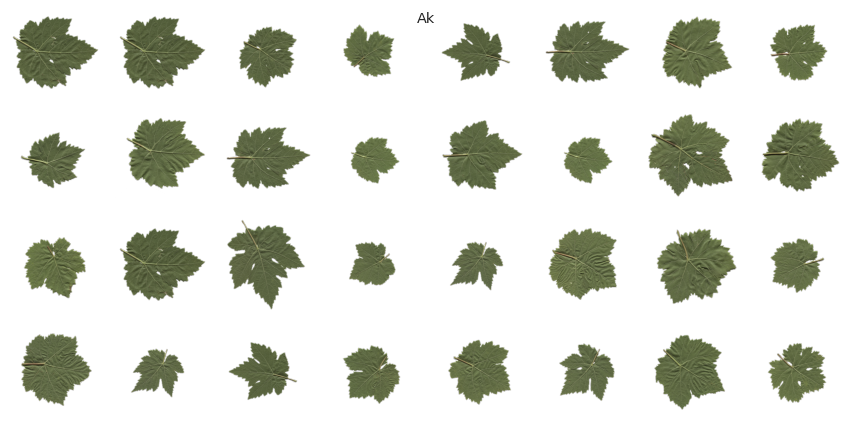

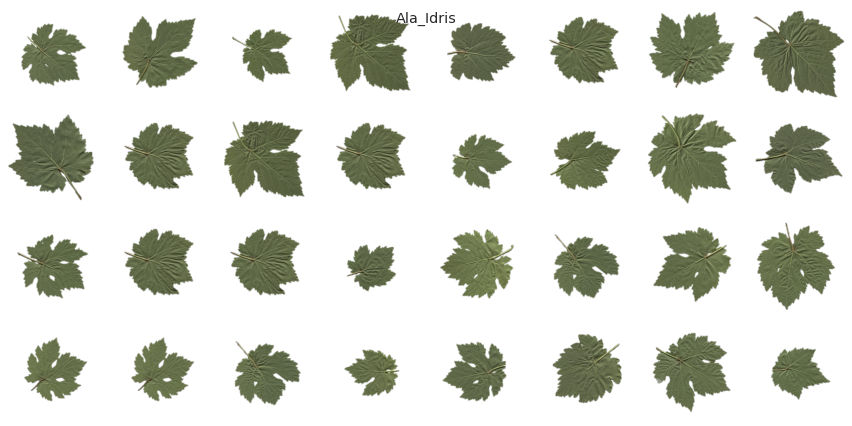

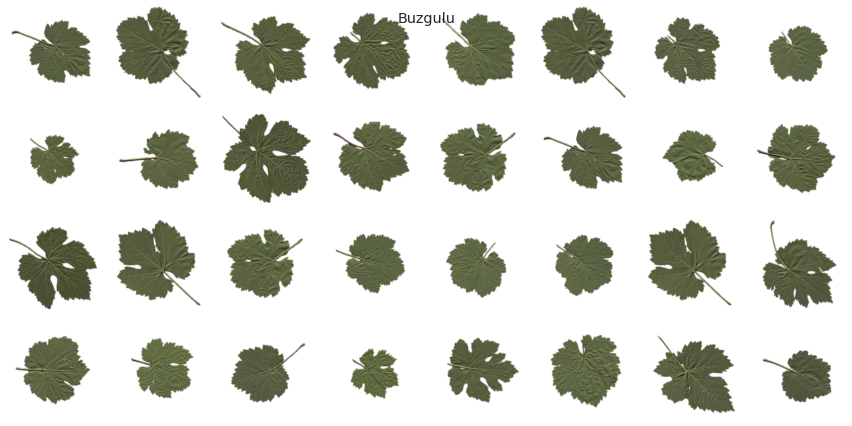

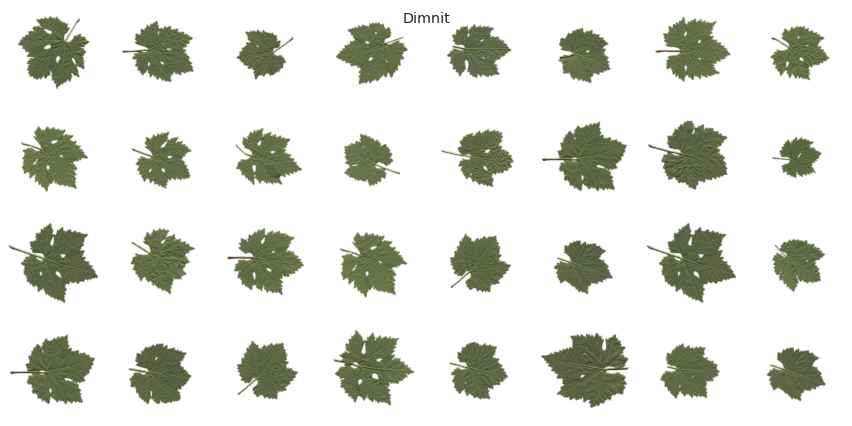

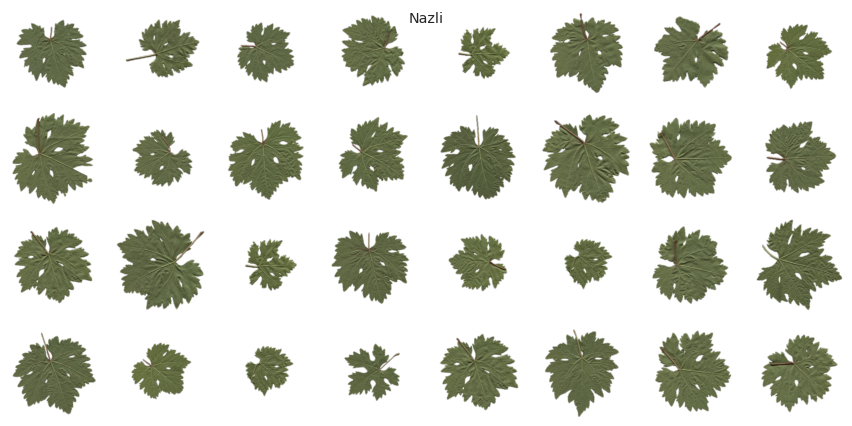

In [ ]:
for leave_name in main_df['classes'].unique():
    plot_species(main_df , leave_name)

In [ ]:
widths, heights = [], []

for path in tqdm(main_df["path"]):
    width, height = Image.open(path).size
    widths.append(width)
    heights.append(height)
    
main_df["width"] = widths
main_df["height"] = heights
main_df["dimension"] = main_df["width"] * main_df["height"]

100%|██████████| 500/500 [00:00<00:00, 7285.45it/s]


In [ ]:
main_df.sort_values('width').head(84)

,images,classes,path,width,height,dimension
0,Ak (92).png,Ak,/content/Grapevine_Leaves_Image_Dataset/Ak/Ak ...,511,511,261121
341,Dimnit (22).png,Dimnit,/content/Grapevine_Leaves_Image_Dataset/Dimnit...,511,511,261121
340,Dimnit (43).png,Dimnit,/content/Grapevine_Leaves_Image_Dataset/Dimnit...,511,511,261121
339,Dimnit (27).png,Dimnit,/content/Grapevine_Leaves_Image_Dataset/Dimnit...,511,511,261121
338,Dimnit (64).png,Dimnit,/content/Grapevine_Leaves_Image_Dataset/Dimnit...,511,511,261121
...,...,...,...,...,...,...
262,Buzgulu (20).png,Buzgulu,/content/Grapevine_Leaves_Image_Dataset/Buzgul...,511,511,261121
261,Buzgulu (51).png,Buzgulu,/content/Grapevine_Leaves_Image_Dataset/Buzgul...,511,511,261121
260,Buzgulu (29).png,Buzgulu,/content/Grapevine_Leaves_Image_Dataset/Buzgul...,511,511,261121
259,Buzgulu (74).png,Buzgulu,/content/Grapevine_Leaves_Image_Dataset/Buzgul...,511,511,261121


In [ ]:
main_df.sort_values('width').tail(84)

,images,classes,path,width,height,dimension
238,Buzgulu (18).png,Buzgulu,/content/Grapevine_Leaves_Image_Dataset/Buzgul...,511,511,261121
237,Buzgulu (25).png,Buzgulu,/content/Grapevine_Leaves_Image_Dataset/Buzgul...,511,511,261121
236,Buzgulu (4).png,Buzgulu,/content/Grapevine_Leaves_Image_Dataset/Buzgul...,511,511,261121
235,Buzgulu (26).png,Buzgulu,/content/Grapevine_Leaves_Image_Dataset/Buzgul...,511,511,261121
188,Ala_Idris (9).png,Ala_Idris,/content/Grapevine_Leaves_Image_Dataset/Ala_Id...,511,511,261121
...,...,...,...,...,...,...
159,Ala_Idris (22).png,Ala_Idris,/content/Grapevine_Leaves_Image_Dataset/Ala_Id...,511,511,261121
158,Ala_Idris (36).png,Ala_Idris,/content/Grapevine_Leaves_Image_Dataset/Ala_Id...,511,511,261121
157,Ala_Idris (10).png,Ala_Idris,/content/Grapevine_Leaves_Image_Dataset/Ala_Id...,511,511,261121
170,Ala_Idris (30).png,Ala_Idris,/content/Grapevine_Leaves_Image_Dataset/Ala_Id...,511,511,261121


In [ ]:
main_df.mean()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  """Entry point for launching an IPython kernel.


width           511.0
height          511.0
dimension    261121.0
dtype: float64

In [ ]:
def is_grey_scale(givenImage):
    w,h = givenImage.size
    for i in range(w):
        for j in range(h):
            r,g,b = givenImage.getpixel((i,j))
            if r != g != b: return False
    return True

In [ ]:
sampleFrac = 0.5
#get our sampled images
isGreyList = []
for imageName in main_df['path'].sample(frac=sampleFrac):
    val = Image.open(imageName).convert('RGB')
    isGreyList.append(is_grey_scale(val))
print(np.sum(isGreyList) / len(isGreyList))
del isGreyList

0.0


In [ ]:
def get_rgb_men(row):
    img = cv2.imread(row['path'])
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return np.sum(img[:,:,0]), np.sum(img[:,:,1]), np.sum(img[:,:,2])

tqdm.pandas()
main_df['R'], main_df['G'], main_df['B'] = zip(*main_df.progress_apply(lambda row: get_rgb_men(row), axis=1))

100%|██████████| 500/500 [00:04<00:00, 118.04it/s]


In [ ]:
def get_rgb_men(row):
    img = cv2.imread(row['path'])
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return np.sum(img[:,:,0]), np.sum(img[:,:,1]), np.sum(img[:,:,2])

tqdm.pandas()
main_df['R'], main_df['G'], main_df['B'] = zip(*main_df.progress_apply(lambda row: get_rgb_men(row), axis=1))

100%|██████████| 500/500 [00:04<00:00, 116.74it/s]


In [ ]:
def show_color_dist(df, count):
    fig, axr = plt.subplots(count,2,figsize=(15,15))
    if df.empty:
        print("Image intensity of selected color is weak")
        return
    for idx, i in enumerate(np.random.choice(df['path'], count)):
        img = cv2.imread(i)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        axr[idx,0].imshow(img)
        axr[idx,0].axis('off')
        axr[idx,1].set_title('R={:.0f}, G={:.0f}, B={:.0f} '.format(np.mean(img[:,:,0]), np.mean(img[:,:,1]), np.mean(img[:,:,2]))) 
        x, y = np.histogram(img[:,:,0], bins=255)
        axr[idx,1].bar(y[:-1], x, label='R', alpha=0.8, color='red')
        x, y = np.histogram(img[:,:,1], bins=255)
        axr[idx,1].bar(y[:-1], x, label='G', alpha=0.8, color='green')
        x, y = np.histogram(img[:,:,2], bins=255)
        axr[idx,1].bar(y[:-1], x, label='B', alpha=0.8, color='blue')
        axr[idx,1].legend()
        axr[idx,1].axis('off')

In [ ]:
# df = main_df[((main_df['B']) < main_df['R']) & ((main_df['G']) < main_df['R'])]
# if df is not None:
#     show_color_dist(df, 8)

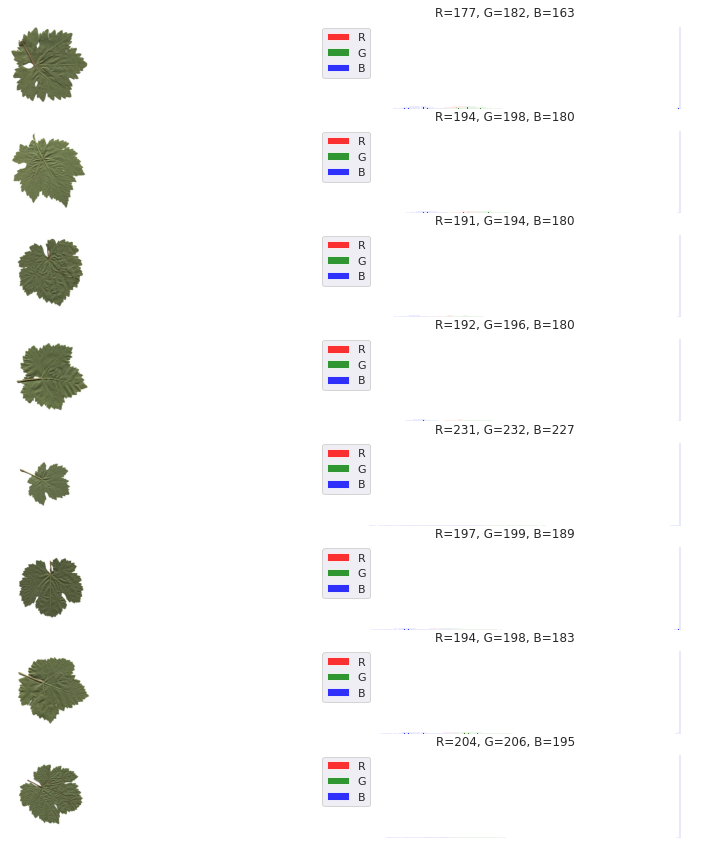

In [ ]:
df = main_df[(main_df['G'] > main_df['R']) & (main_df['G'] > main_df['B'])]
show_color_dist(df, 8)

## Features

### Edges

In [ ]:
def edges_images_gray(class_name):
    classes_df = main_df[main_df['classes'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(main_df['path'],4)):
        image = cv2.imread(i)
        gray=cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        edges = sobel(image)
        gray_edges=canny(gray)
        dimension = edges.shape
        fig = plt.figure(figsize=(8, 8))
        plt.suptitle(class_name)
        plt.subplot(2,2,1)
        plt.imshow(gray_edges)
        plt.subplot(2,2,2)
        plt.imshow(edges[:dimension[0],:dimension[1],0], cmap="gray")
        plt.subplot(2,2,3)
        plt.imshow(edges[:dimension[0],:dimension[1],1], cmap='gray')
        plt.subplot(2,2,4)
        plt.imshow(edges[:dimension[0],:dimension[1],2], cmap='gray')
        plt.show()

In [ ]:
def edges_images_white(class_name):
    classes_df = main_df[main_df['classes'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(main_df['path'],4)):
        image = cv2.imread(i)
        gray=cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        edges = sobel(image)
        gray_edges=canny(gray)
        dimension = edges.shape
        fig = plt.figure(figsize=(8, 8))
        plt.suptitle(class_name)
        plt.subplot(2,2,1)
        plt.imshow(gray_edges)
        plt.subplot(2,2,2)
        plt.imshow(edges[:dimension[0],:dimension[1],0], cmap="BuGn")
        plt.subplot(2,2,3)
        plt.imshow(edges[:dimension[0],:dimension[1],1], cmap='BuGn')
        plt.subplot(2,2,4)
        plt.imshow(edges[:dimension[0],:dimension[1],2], cmap='BuGn')
        plt.show()

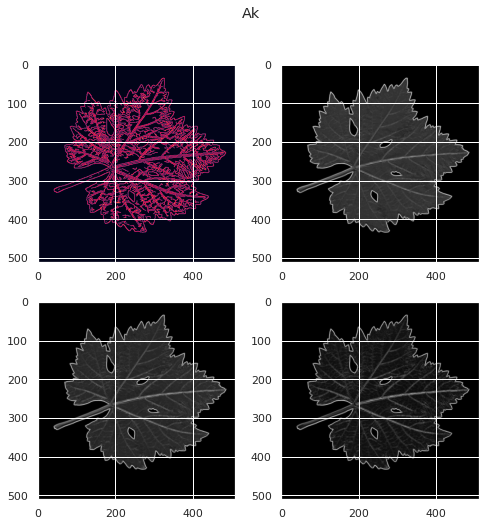

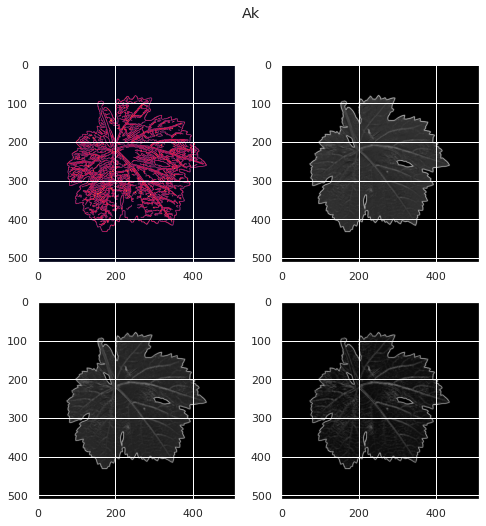

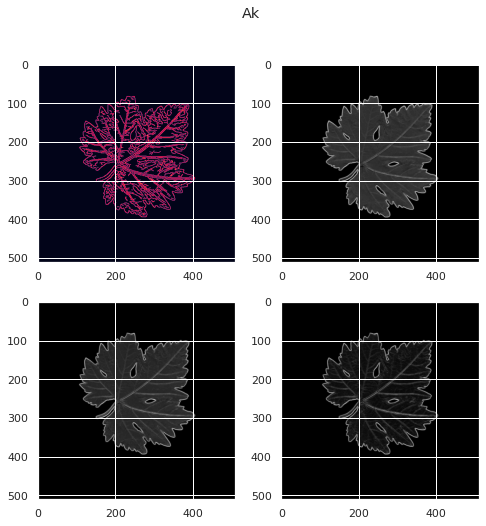

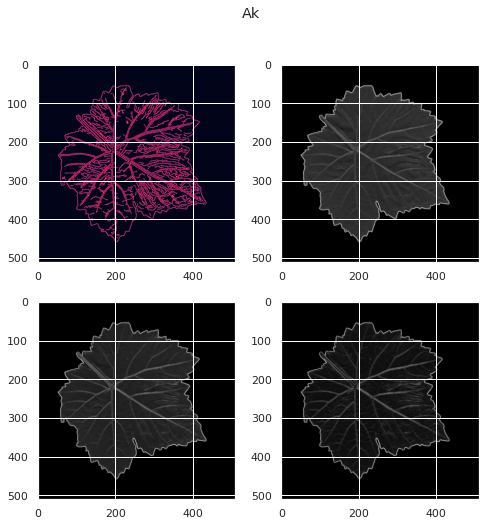

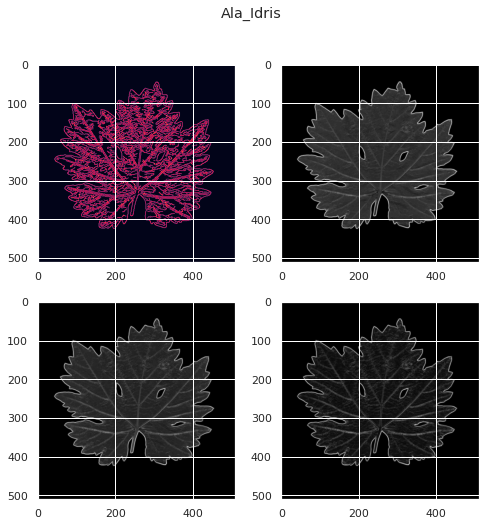

...

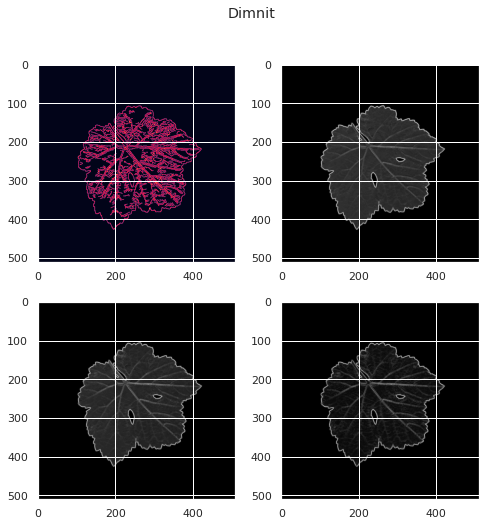

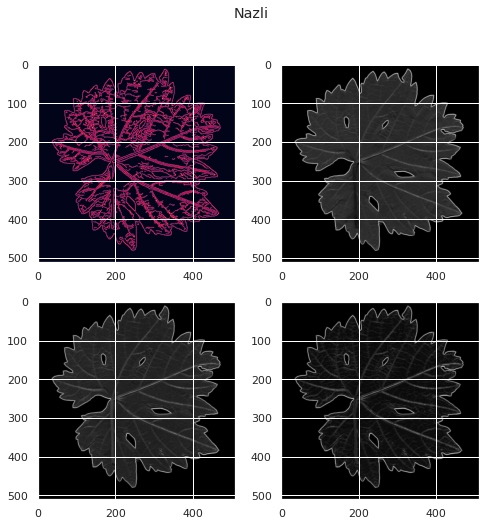

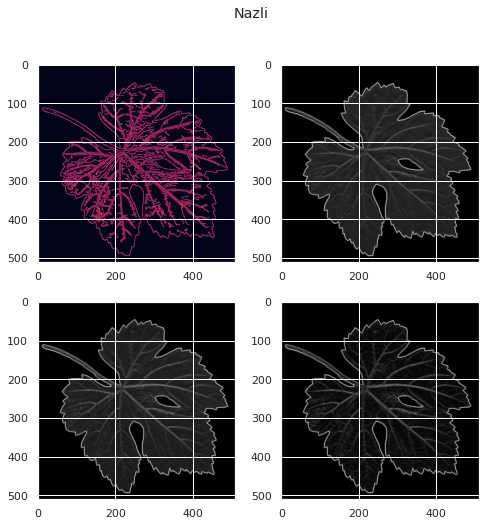

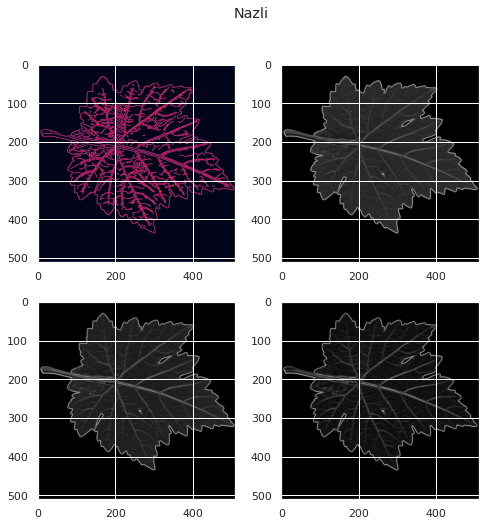

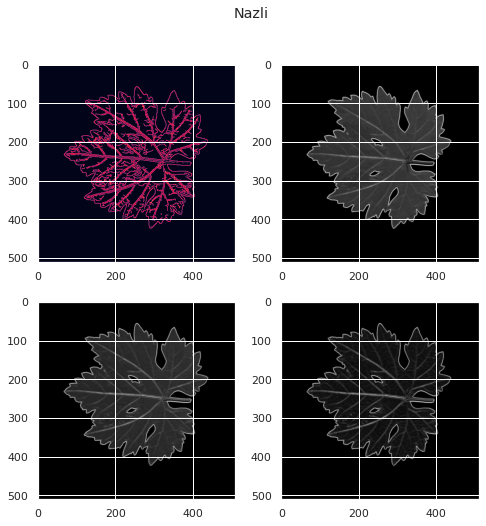

In [ ]:
for class_name in main_df['classes'].unique():
    edges_images_gray(class_name)

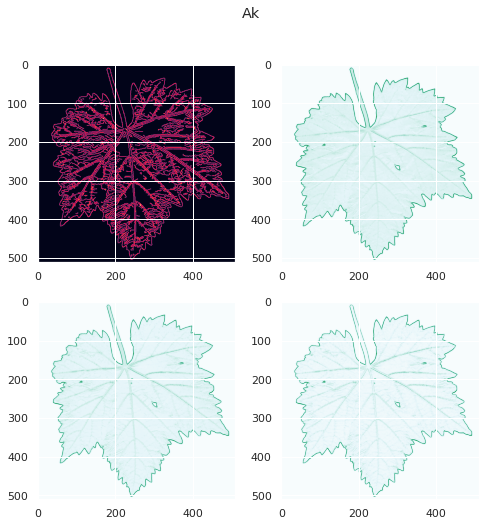

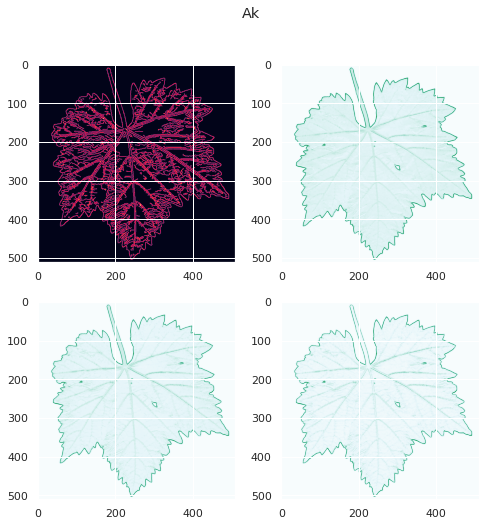

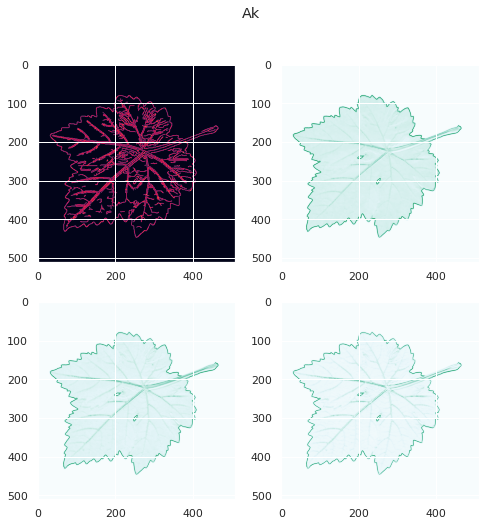

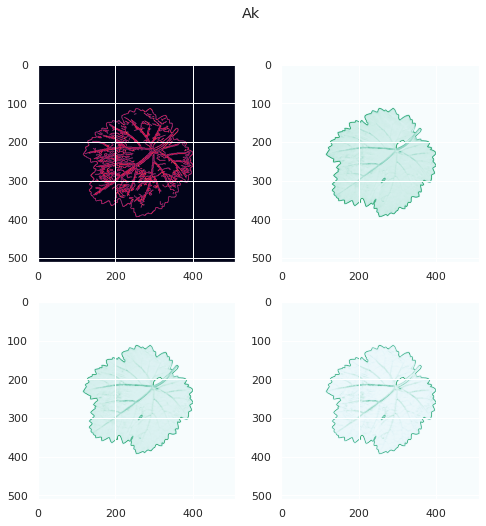

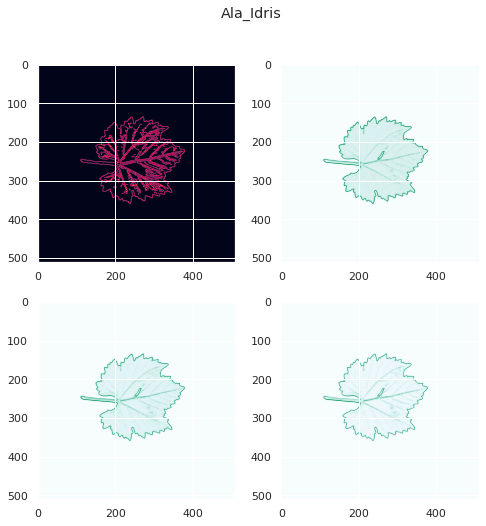

...

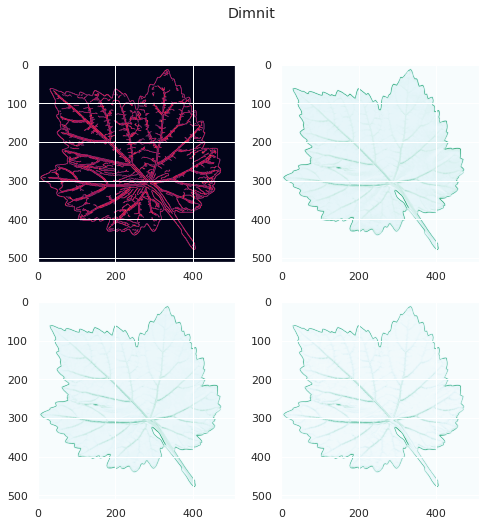

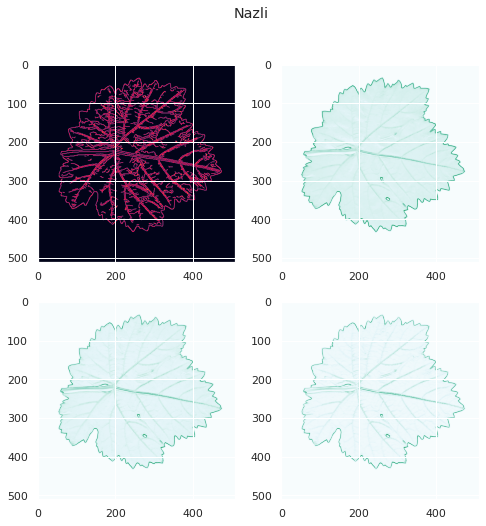

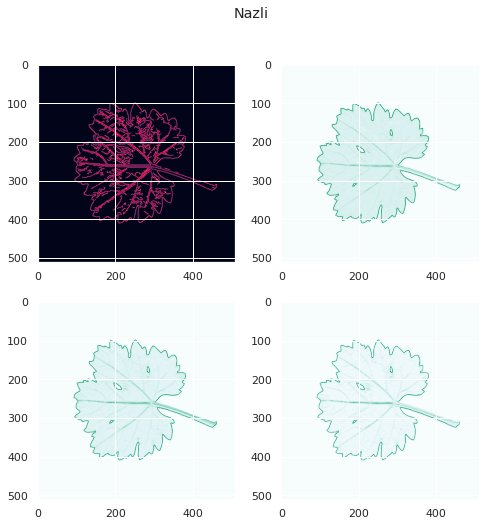

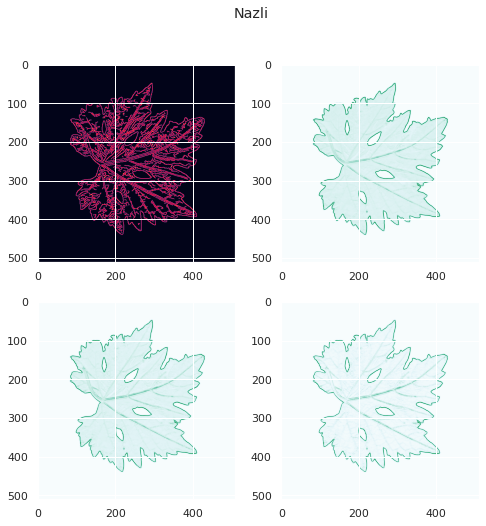

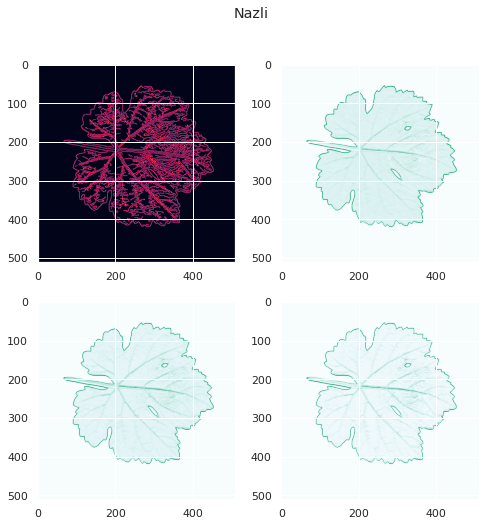

In [ ]:
for class_name in main_df['classes'].unique():
    edges_images_white(class_name)

### Corners

In [ ]:
def corners_images_gray(class_name):
    classes_df = main_df[main_df['classes'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(main_df['path'],4)):
        image = cv2.imread(i)
        gray=cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        corners_gray = cv2.goodFeaturesToTrack(gray, maxCorners=50, qualityLevel=0.02, minDistance=20)
        corners_gray = np.float32(corners_gray)
        for item in corners_gray:
            x, y = item[0]
            cv2.circle(image, (int(x), int(y)), 6, (0, 255, 0), -1)
        fig = plt.figure(figsize=(8, 8))
        plt.suptitle(class_name)
        plt.subplot(2,2,1)
        plt.imshow(image, cmap="BuGn")
        plt.show()

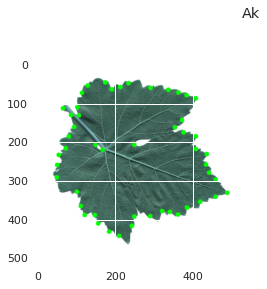

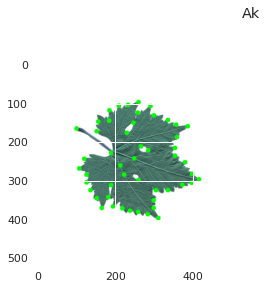

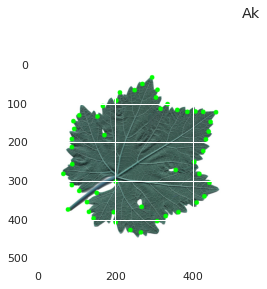

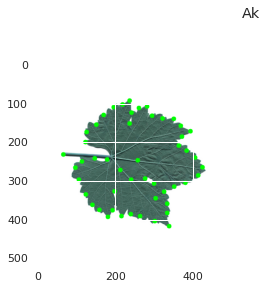

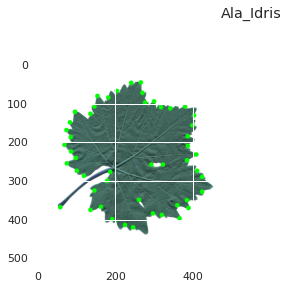

...

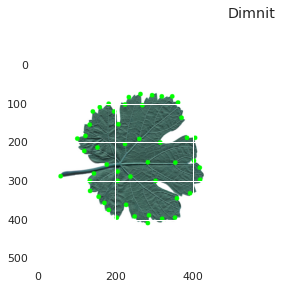

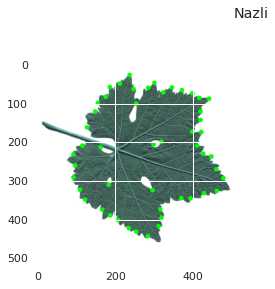

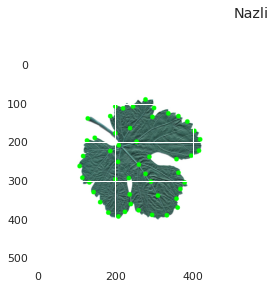

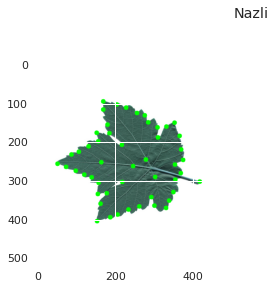

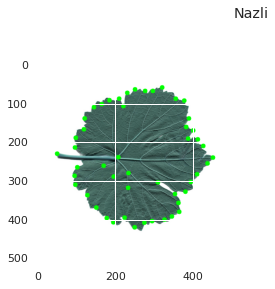

In [ ]:
for class_name in main_df['classes'].unique():
    corners_images_gray(class_name)

### Sift Features

In [ ]:
def sift_images_gray(class_name):
    classes_df = main_df[main_df['classes'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(main_df['path'],4)):
        image = cv2.imread(i)
        gray=cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        sift = cv2.SIFT_create()
        kp, des = sift.detectAndCompute(gray, None)
        kp_img = cv2.drawKeypoints(image, kp, None, color=(0, 255, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        fig = plt.figure(figsize=(8, 8))
        plt.suptitle(class_name)
        plt.subplot(2,2,1)
        plt.imshow(kp_img, cmap="viridis")
        plt.show()

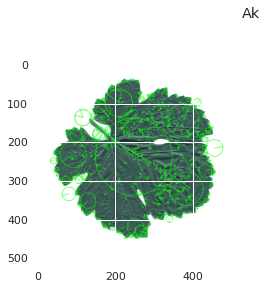

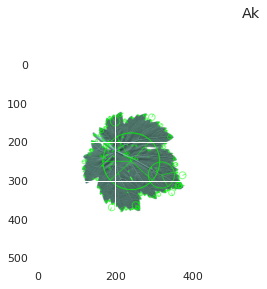

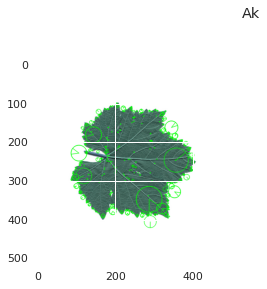

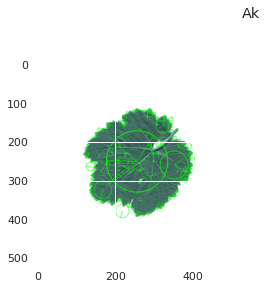

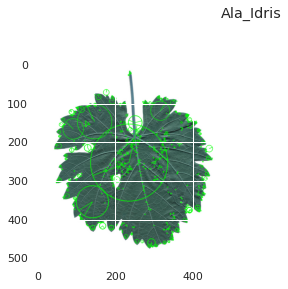

...

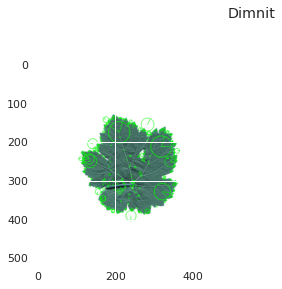

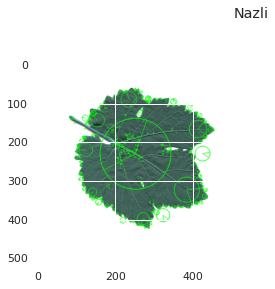

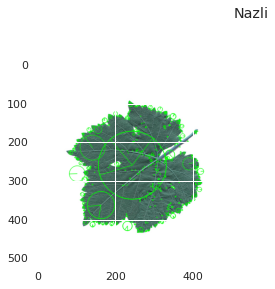

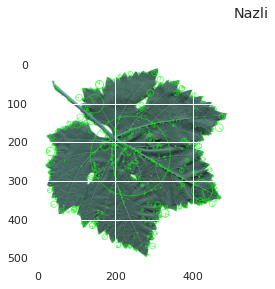

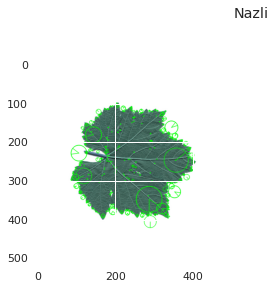

In [ ]:
for class_name in main_df['classes'].unique():
    sift_images_gray(class_name)

### HOG

In [ ]:
def hog_images(class_name):
    classes_df = main_df[main_df['classes'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(main_df['path'],4)):
        image = cv2.imread(i)
        fd, hog_image = hog(image, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(2, 2), visualize=True, multichannel=True)
        fig = plt.figure(figsize=(8, 8))
        plt.suptitle(class_name)
        plt.subplot(2,2,1)
        plt.imshow(hog_image, cmap="gray")
        plt.show()

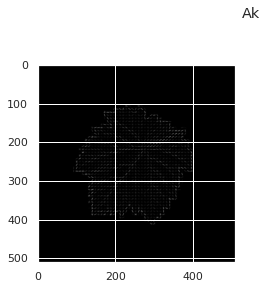

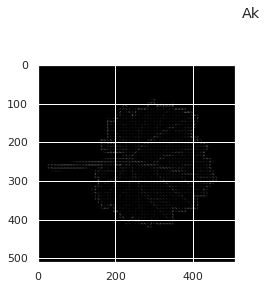

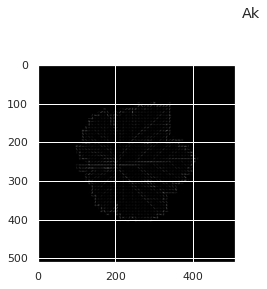

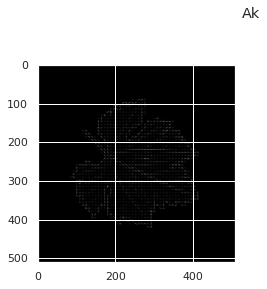

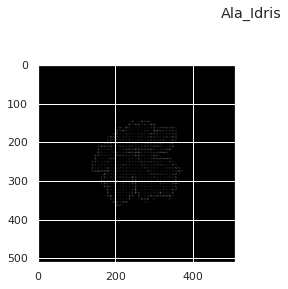

...

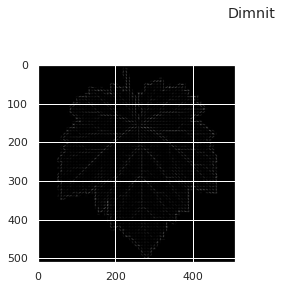

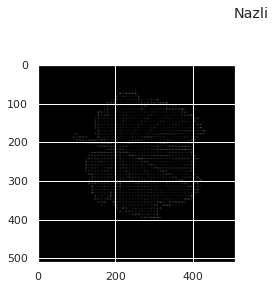

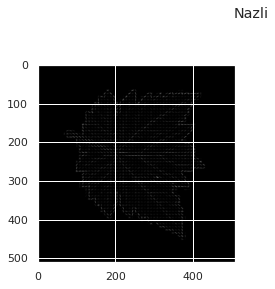

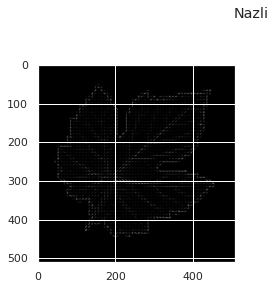

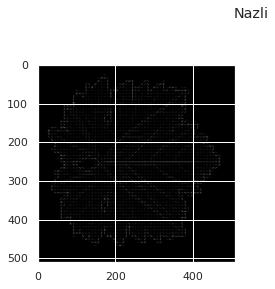

In [ ]:
for class_name in main_df['classes'].unique():
    hog_images(class_name)

## Augmentations

In [ ]:
def plot_augimages(paths, datagen):
    plt.figure(figsize = (14,28))
    plt.suptitle('Augmented Images')
    
    midx = 0
    for path in paths:
        data = Image.open(path)
        data = data.resize((224,224))
        samples = expand_dims(data, 0)
        it = datagen.flow(samples, batch_size=1)
    
        # Show Original Image
        plt.subplot(10,5, midx+1)
        plt.imshow(data)
        plt.axis('off')
    
        # Show Augmented Images
        for idx, i in enumerate(range(4)):
            midx += 1
            plt.subplot(10,5, midx+1)
            
            batch = it.next()
            image = batch[0].astype('uint8')
            plt.imshow(image)
            plt.axis('off')
        midx += 1
    
    plt.tight_layout()
    plt.show()

## Data Generators

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(main_df[['path', 'classes']], main_df[['classes']], test_size=0.2,random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2)

In [ ]:
print('X_train=',np.shape(X_train))
print('X_test=',np.shape(X_test))
print('X_val=',np.shape(X_val))
print('y_train=',np.shape(y_train))
print('y_test=',np.shape(y_test))
print('y_val=',np.shape(y_val))

X_train= (320, 2)
X_test= (100, 2)
X_val= (80, 2)
y_train= (320, 1)
y_test= (100, 1)
y_val= (80, 1)


## Generators

### Alexnet Generators

In [ ]:
alexnet_datagen = ImageDataGenerator(
    rotation_range=20,
    zoom_range=0.10,
    brightness_range=[0.6,1.4],
    channel_shift_range=0.7,
    width_shift_range=0.15,
    height_shift_range=0.15,
    shear_range=0.15,
    horizontal_flip=True,
    fill_mode='nearest',
) 

train_generator_alexnet = alexnet_datagen.flow_from_dataframe(
        X_train,  # This is the source directory for training images
        x_col='path',
        y_col='classes',
        target_size=(227, 227),  # All images will be resized to 150x150
        batch_size=32,
        class_mode="categorical",
        shuffle=True,
)
val_generator_alexnet = alexnet_datagen.flow_from_dataframe(
        X_val,  # This is the source directory for training images
        x_col='path',
        y_col='classes',
        target_size=(227, 227),  # All images will be resized to 150x150
        batch_size=32,
        class_mode="categorical",
        shuffle=True,
)

Found 320 validated image filenames belonging to 5 classes.
Found 80 validated image filenames belonging to 5 classes.


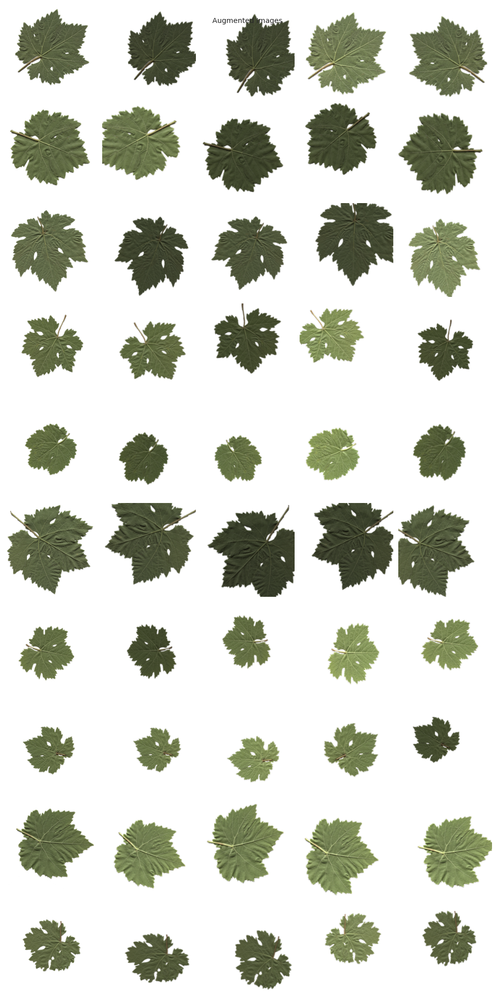

In [ ]:
plot_augimages(np.random.choice(main_df['path'],10), alexnet_datagen)

### Resnet50 Generators

In [ ]:
from tensorflow.keras.applications.resnet50 import preprocess_input

In [ ]:
resnet50_datagen = ImageDataGenerator(
    rotation_range=20,
    zoom_range=0.10,
    brightness_range=[0.6,1.4],
    channel_shift_range=0.7,
    width_shift_range=0.15,
    height_shift_range=0.15,
    shear_range=0.15,
    horizontal_flip=True,
    fill_mode='nearest',
    preprocessing_function=preprocess_input
) 

train_generator_resnet50 = resnet50_datagen.flow_from_dataframe(
        X_train,  # This is the source directory for training images
        x_col='path',
        y_col='classes',
        target_size=(227, 227),  # All images will be resized to 150x150
        batch_size=32,
        class_mode="categorical",
        shuffle=True,
)
val_generator_resnet50 = resnet50_datagen.flow_from_dataframe(
        X_val,  # This is the source directory for training images
        x_col='path',
        y_col='classes',
        target_size=(227, 227),  # All images will be resized to 150x150
        batch_size=32,
        class_mode="categorical",
        shuffle=True,
)

Found 320 validated image filenames belonging to 5 classes.
Found 80 validated image filenames belonging to 5 classes.


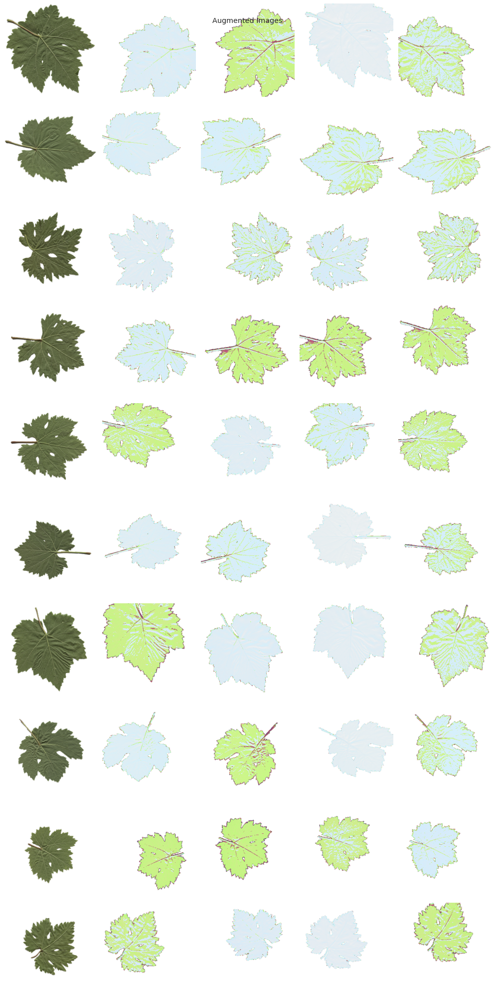

In [ ]:
try:
    plot_augimages(np.random.choice(main_df['path'],10), resnet50_datagen)
except:
    print("continue no issues")

### VGG Generators

In [ ]:
from keras.applications.vgg19 import preprocess_input
vgg_datagen = ImageDataGenerator(
    rotation_range=20,
    zoom_range=0.10,
    brightness_range=[0.6,1.4],
    channel_shift_range=0.7,
    width_shift_range=0.15,
    height_shift_range=0.15,
    shear_range=0.15,
    horizontal_flip=True,
    fill_mode='nearest',
    preprocessing_function=preprocess_input
) 

train_generator_vgg = vgg_datagen.flow_from_dataframe(
        X_train,  # This is the source directory for training images
        x_col='path',
        y_col='classes',
        target_size=(227, 227),  # All images will be resized to 150x150
        batch_size=32,
        class_mode="categorical",
        shuffle=True,
)
val_generator_vgg = vgg_datagen.flow_from_dataframe(
        X_val,  # This is the source directory for training images
        x_col='path',
        y_col='classes',
        target_size=(227, 227),  # All images will be resized to 150x150
        batch_size=32,
        class_mode="categorical",
        shuffle=True,
)

Found 320 validated image filenames belonging to 5 classes.
Found 80 validated image filenames belonging to 5 classes.


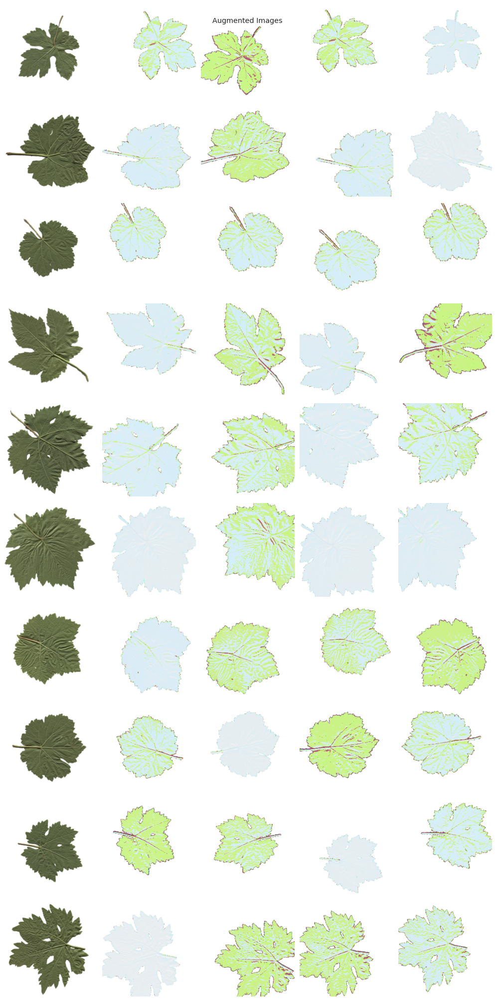

In [ ]:
plot_augimages(np.random.choice(main_df['path'],10), vgg_datagen)

## Modelling


### Initalize VGG19

In [ ]:
vgg19 = VGG19(include_top = False, input_shape = (227,227,3), weights = 'imagenet')

# training of all the convolution is set to false
for layer in vgg19.layers:
    layer.trainable = False

x = GlobalAveragePooling2D()(vgg19.output)
predictions = Dense(5, activation='softmax')(x)

model_vgg = Model(inputs = vgg19.input, outputs = predictions)

80150528/80134624 [==============================] - 1s 0us/step


### Initalize Alexnet

In [ ]:
def AlexNet():
    model = tf.keras.models.Sequential([
        # Here, we use a larger 11 x 11 window to capture objects. At the same
        # time, we use a stride of 4 to greatly reduce the height and width of
        # the output. Here, the number of output channels is much larger than
        # that in LeNet
        tf.keras.layers.Conv2D(filters=96, kernel_size=11, strides=4,
                               activation='relu', input_shape=(227,227,3)),
        tf.keras.layers.MaxPool2D(pool_size=3, strides=2),
        # Make the convolution window smaller, set padding to 2 for consistent
        # height and width across the input and output, and increase the
        # number of output channels
        tf.keras.layers.Conv2D(filters=256, kernel_size=5, padding='same',
                               activation='relu'),
        tf.keras.layers.MaxPool2D(pool_size=3, strides=2),
        # Use three successive convolutional layers and a smaller convolution
        # window. Except for the final convolutional layer, the number of
        # output channels is further increased. Pooling layers are not used to
        # reduce the height and width of input after the first two
        # convolutional layers
        tf.keras.layers.Conv2D(filters=384, kernel_size=3, padding='same',
                               activation='relu'),
        tf.keras.layers.Conv2D(filters=384, kernel_size=3, padding='same',
                               activation='relu'),
        tf.keras.layers.Conv2D(filters=256, kernel_size=3, padding='same',
                               activation='relu'),
        tf.keras.layers.MaxPool2D(pool_size=3, strides=2),
    ])
    return model

In [ ]:
alexnet = AlexNet()

# training of all the convolution is set to false
for layer in alexnet.layers:
    alexnet.trainable = True

x = GlobalAveragePooling2D()(alexnet.output)
predictions = Dense(5, activation='softmax')(x)

model_alexnet = Model(inputs = alexnet.input, outputs = predictions)

### Initalize Resnet 50

In [ ]:
resnet50 = ResNet50(include_top = False, input_shape = (227,227,3), weights = 'imagenet')

# training of all the convolution is set to false
for layer in resnet50.layers:
    layer.trainable = False

x = GlobalAveragePooling2D()(resnet50.output)
predictions = Dense(5, activation='softmax')(x)

model_resnet50 = Model(inputs = resnet50.input, outputs = predictions)

94781440/94765736 [==============================] - 2s 0us/step


## Compilation

### VGG Compilation

In [ ]:
model_vgg.compile(loss='categorical_crossentropy', optimizer="adam", metrics=['accuracy'])

### Resnet Compilation

In [ ]:
model_resnet50.compile(loss='categorical_crossentropy', optimizer="adam", metrics=['accuracy'])

###Alexnet Compilation

In [ ]:
model_alexnet.compile(loss='categorical_crossentropy', optimizer="adam", metrics=['accuracy'])

## Fitting

###Fitting Vgg

In [ ]:
history_vgg = model_vgg.fit(
      train_generator_vgg,
      validation_data=val_generator_vgg,
      epochs=50,
      verbose=2)

Epoch 1/50
10/10 - 275s - loss: 2.2658 - accuracy: 0.1688 - val_loss: 2.1387 - val_accuracy: 0.2125 - 275s/epoch - 28s/step
Epoch 2/50
10/10 - 270s - loss: 1.7863 - accuracy: 0.3281 - val_loss: 1.9021 - val_accuracy: 0.2375 - 270s/epoch - 27s/step
Epoch 3/50
10/10 - 272s - loss: 1.5537 - accuracy: 0.3250 - val_loss: 1.7376 - val_accuracy: 0.2875 - 272s/epoch - 27s/step
Epoch 4/50
10/10 - 274s - loss: 1.4027 - accuracy: 0.4281 - val_loss: 1.4498 - val_accuracy: 0.4125 - 274s/epoch - 27s/step
Epoch 5/50
10/10 - 273s - loss: 1.2904 - accuracy: 0.4344 - val_loss: 1.4020 - val_accuracy: 0.4625 - 273s/epoch - 27s/step
Epoch 6/50
10/10 - 271s - loss: 1.1651 - accuracy: 0.5156 - val_loss: 1.3299 - val_accuracy: 0.5000 - 271s/epoch - 27s/step
Epoch 7/50
10/10 - 269s - loss: 1.0705 - accuracy: 0.5844 - val_loss: 1.2322 - val_accuracy: 0.4875 - 269s/epoch - 27s/step
Epoch 8/50
10/10 - 268s - loss: 1.0088 - accuracy: 0.6031 - val_loss: 1.1955 - val_accuracy: 0.5875 - 268s/epoch - 27s/step
Epoch 9/

###Fitting Alexnet

In [ ]:
history_alexnet = model_alexnet.fit(
      train_generator_vgg,
      validation_data=val_generator_vgg,
      epochs=50,
      verbose=2)

###Fitting Resnet50

In [ ]:
history_resnet50 = model_resnet50.fit(
      train_generator_resnet50,
      validation_data=val_generator_resnet50,
      epochs=50,
      verbose=2)

## Analyzing

###Analyzing perfomance of VGG

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(history_vgg.history['accuracy'])
plt.plot(history_vgg.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.show()

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(history_vgg.history['loss'])
plt.plot(history_vgg.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('Epoch')
plt.show()

###Analyzing perfomance of VGG

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(history_vgg.history['accuracy'])
plt.plot(history_vgg.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.show()

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(history_vgg.history['loss'])
plt.plot(history_vgg.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('Epoch')
plt.show()

###Analyzing perfomance of Resnet50

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(history_resnet50.history['accuracy'])
plt.plot(history_resnet50.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.show()

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(history_resnet50.history['loss'])
plt.plot(history_resnet50.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('Epoch')
plt.show()

###Analyzing perfomance of Alexnet

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(history_alexnet.history['accuracy'])
plt.plot(history_alexnet.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.show()

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(history_alexnet.history['loss'])
plt.plot(history_alexnet.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('Epoch')
plt.show()

## Evaluate VGG Model

In [ ]:
from keras.applications.vgg19 import preprocess_input

test_generator_vgg = vgg_datagen.flow_from_dataframe(
        X_test,  # This is the source directory for training images
        x_col='path',
        y_col='classes',
        target_size=(227, 227),  # All images will be resized to 150x150
        batch_size=128,
        class_mode="categorical",
        shuffle=True,
)

Found 100 validated image filenames belonging to 5 classes.


In [ ]:
# evaluate accuracy on test data
test_loss, test_acc = model_vgg.evaluate(test_generator_vgg, verbose=2)
print('\nTest accuracy:', test_acc,'Test loss:',test_loss)

1/1 - 69s - loss: 0.6922 - accuracy: 0.7700 - 69s/epoch - 69s/step

Test accuracy: 0.7699999809265137 Test loss: 0.6922000646591187


In [ ]:
prediction = model_vgg.predict(test_generator_vgg)
y_pred = prediction
y_pred_bool = np.argmax(y_pred, axis=1)

In [ ]:
new_y_test = y_test['classes'].to_numpy()
y_test_bool = np.zeros((100,1))
m=0
for i in range(100):
  if new_y_test[i]=='Ak':
    y_test_bool[m,0]=0
    m+=1

  elif new_y_test[i]=='Ala_Idris':
    y_test_bool[m,0]=1
    m+=1

  elif new_y_test[i]=='Buzgulu':
    y_test_bool[m,0]=2
    m+=1

  elif new_y_test[i]=='Dimnit':
    y_test_bool[m,0]=3
    m+=1

  elif new_y_test[i]=='Nazli':
    y_test_bool[m,0]=4
    m+=1

# Model 4) CNN with data augmentation By pretrained VGG19 and K Fold

## randomly shuffle and make train and valid dataset

In [ ]:
#randomly the data
new_x_train, new_y_train = shuffle(X, Y)
len(new_x_train),len(new_y_train)

(500, 500)

In [ ]:
x_train, x_test, y_train, y_test= train_test_split(new_x_train, new_y_train, test_size=0.2, random_state=42)
print('x_train=',np.shape(x_train))
print('y_train=',np.shape(y_train))
print('x_test=',np.shape(x_test))
print('y_test=',np.shape(y_test))

x_train= (400, 153, 153, 3)
y_train= (400,)
x_test= (100, 153, 153, 3)
y_test= (100,)


## Data Augmentation

**Final Data Augmentation**

In [ ]:
new_x_train = np.zeros((2800,153,153,3))
datagen = ImageDataGenerator(width_shift_range=0.1, height_shift_range=0.1, rotation_range=90,brightness_range=[0.1,1.0], horizontal_flip=True)
m=0
for j in range (400):
  data = img_to_array(x_train[j,:,:,:])
  for i in range(7):
    samples1 = expand_dims(data,0)
    it1 = datagen.flow(samples1, batch_size=1)
    batch1 = it1.next()
    image1 = batch1[0].astype('uint8')
    new_x_train[m,:,:,:]= batch1
    m+=1

In [ ]:
new_y_train = np.zeros((2800,1))
m=0
for j in range (400):
  data = y_train[j]
  for i in range(7):
      new_y_train[m,:] = data
      m+=1
new_x_train = convert(new_x_train, 0, 255, np.uint8)

In [ ]:
print(np.shape(new_x_train))
print(np.shape(new_y_train))

(2800, 153, 153, 3)
(2800, 1)


## preprocess data for VGG19

In [ ]:
trainX = np.zeros((2800,32,32,3))
for i in range (2800):
    data = new_x_train[i]
    width, height = int(data.shape[1]/4.78125), int(data.shape[0]/4.78125)
    resized_data = cv2.resize(data, 
                            (width, height), 
                            interpolation = cv2.INTER_AREA,)
    trainX[i,:,:,:] = resized_data


# trainX = convert(trainX, 0, 255, np.uint8)
trainX = new_x_train
trainY = new_y_train

print('Train: X=%s, y=%s' % (trainX.shape, trainY.shape)) 

Train: X=(2800, 153, 153, 3), y=(2800, 5)


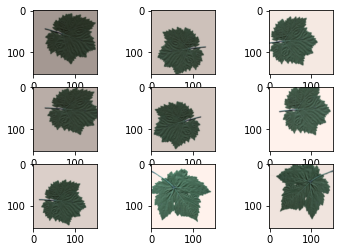

In [ ]:
import tensorflow as tf
from matplotlib import pyplot 

for i in range(9):
  # define subplot
  pyplot.subplot(330 + 1 + i) 
  # plot raw pixel data
  pyplot.imshow(trainX[i], cmap=pyplot.get_cmap('gray'))
  # show the figure
pyplot.show()

##Use pretrained Model

In [ ]:
image_input = tf.keras.layers.Input(shape=(153,153, 3))
baseModel_VGG_19 = tf.keras.applications.VGG19(include_top=False,weights='imagenet',input_tensor=image_input)
baseModel_VGG_19.summary() 

Model: "vgg19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_7 (InputLayer)        [(None, 153, 153, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 153, 153, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 153, 153, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 76, 76, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 76, 76, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 76, 76, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 38, 38, 128)       0     

In [ ]:
for i,layer in enumerate(baseModel_VGG_19.layers):
  layer.trainable=False       
  print("Layer Number :",i, "Layer Name :", layer.name, "Layer Shape(Input_Shape,Output Shape) : (",layer.input_shape,layer.output_shape, ") is Trainable:", layer.trainable,"No of Parameter :",layer.count_params()) 

Layer Number : 0 Layer Name : input_7 Layer Shape(Input_Shape,Output Shape) : ( [(None, 153, 153, 3)] [(None, 153, 153, 3)] ) is Trainable: False No of Parameter : 0
Layer Number : 1 Layer Name : block1_conv1 Layer Shape(Input_Shape,Output Shape) : ( (None, 153, 153, 3) (None, 153, 153, 64) ) is Trainable: False No of Parameter : 1792
Layer Number : 2 Layer Name : block1_conv2 Layer Shape(Input_Shape,Output Shape) : ( (None, 153, 153, 64) (None, 153, 153, 64) ) is Trainable: False No of Parameter : 36928
Layer Number : 3 Layer Name : block1_pool Layer Shape(Input_Shape,Output Shape) : ( (None, 153, 153, 64) (None, 76, 76, 64) ) is Trainable: False No of Parameter : 0
Layer Number : 4 Layer Name : block2_conv1 Layer Shape(Input_Shape,Output Shape) : ( (None, 76, 76, 64) (None, 76, 76, 128) ) is Trainable: False No of Parameter : 73856
Layer Number : 5 Layer Name : block2_conv2 Layer Shape(Input_Shape,Output Shape) : ( (None, 76, 76, 128) (None, 76, 76, 128) ) is Trainable: False No of P

In [ ]:
FC_layer_Flatten = tf.keras.layers.Flatten()(baseModel_VGG_19.output)  
Dense=tf.keras.layers.Dense(units=1000,activation="relu")(FC_layer_Flatten)
Dense=tf.keras.layers.Dense(units=800,activation="relu")(Dense)
Dense=tf.keras.layers.Dropout(.3)(Dense)
Dense=tf.keras.layers.Dense(units=400,activation="relu")(Dense)
Dense=tf.keras.layers.Dense(units=200,activation="relu")(Dense)
Dense=tf.keras.layers.Dense(units=100,activation="relu")(Dense)
Classification=tf.keras.layers.Dense(units=5,activation="softmax")(Dense)

In [ ]:
for i,layer in enumerate(baseModel_VGG_19.layers):
  layer.trainable=False       
  print("Layer Number :",i, "Layer Name :", layer.name, "Layer Shape(Input_Shape,Output Shape) : (",layer.input_shape,layer.output_shape, ") is Trainable:", layer.trainable,"No of Parameter :",layer.count_params()) 

Layer Number : 0 Layer Name : input_7 Layer Shape(Input_Shape,Output Shape) : ( [(None, 153, 153, 3)] [(None, 153, 153, 3)] ) is Trainable: False No of Parameter : 0
Layer Number : 1 Layer Name : block1_conv1 Layer Shape(Input_Shape,Output Shape) : ( (None, 153, 153, 3) (None, 153, 153, 64) ) is Trainable: False No of Parameter : 1792
Layer Number : 2 Layer Name : block1_conv2 Layer Shape(Input_Shape,Output Shape) : ( (None, 153, 153, 64) (None, 153, 153, 64) ) is Trainable: False No of Parameter : 36928
Layer Number : 3 Layer Name : block1_pool Layer Shape(Input_Shape,Output Shape) : ( (None, 153, 153, 64) (None, 76, 76, 64) ) is Trainable: False No of Parameter : 0
Layer Number : 4 Layer Name : block2_conv1 Layer Shape(Input_Shape,Output Shape) : ( (None, 76, 76, 64) (None, 76, 76, 128) ) is Trainable: False No of Parameter : 73856
Layer Number : 5 Layer Name : block2_conv2 Layer Shape(Input_Shape,Output Shape) : ( (None, 76, 76, 128) (None, 76, 76, 128) ) is Trainable: False No of P

In [ ]:
model_final = tf.keras.Model(inputs=image_input,outputs=Classification)
model_final.summary()

Model: "model_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_7 (InputLayer)        [(None, 153, 153, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 153, 153, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 153, 153, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 76, 76, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 76, 76, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 76, 76, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 38, 38, 128)       0   

In [ ]:
base_learning_rate = 0.0001
model_final.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=base_learning_rate),loss=tf.keras.losses.CategoricalCrossentropy(),metrics=['accuracy'])

## retrain VGG19 By our dataset 

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, Conv2D, MaxPooling2D
from tensorflow.keras.losses import sparse_categorical_crossentropy
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import KFold
from sklearn.metrics import accuracy_score

acc_per_fold = []
loss_per_fold = []

acc = []
val_acc = []
loss = []
val_loss = []
# Define the K-fold Cross Validator
num_folds = 10
kfold = KFold(n_splits=num_folds, shuffle=True)

# K-fold Cross Validation model evaluation
fold_no = 10

early = tf.keras.callbacks.EarlyStopping(monitor="val_loss", mode="min", patience=10)
check_point = tf.keras.callbacks.ModelCheckpoint("./k_fold_model.h5", monitor="val_loss", save_best_only=True)
rreduce = tf.keras.callbacks.ReduceLROnPlateau(monitor="val_loss", factor=0.01, patience=6)

callbacks_list = [early, check_point, rreduce]

for train, test in kfold.split(trainX,trainY):

  # # Define the model_final architecture
  IMG_HEIGHT = 128

  # Compile the model
  model_final.compile(optimizer='RMSprop',
              loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              metrics=['accuracy'])

  # Generate a print
  # print('------------------------------------------------------------------------')
  # print(f'Training for fold {fold_no} ...')

  # Fit data to model

  epochs = 50
  batch_size = 30
  history = model_final.fit(
      trainX[train],
      to_categorical(trainY[train]),
      steps_per_epoch= len(trainX) // batch_size,
      epochs=epochs
  )
  acc.append(history.history['accuracy'])
  loss.append(history.history['loss'])
  # Generate generalization metrics
  scores = model_final.evaluate(trainX[test],trainY[test] verbose=0)
  print(f'Score for fold {fold_no}: {model_final.metrics_names[0]} of {scores[0]}; {model_final.metrics_names[1]} of {scores[1]}')
  acc_per_fold.append(scores[1])
  loss_per_fold.append(scores[0])

  # Increase fold number
  fold_no = fold_no + 1

87/87 [==============================] - 34s 395ms/step - loss: 0.0448 - accuracy: 0.9873
accuracy of each fold - [0.375, 0.2, 0.45, 0.85, 0.6, 0.475, 0.6, 0.85, 0.775, 0.75, 0.8, 0.625, 0.75, 0.45, 0.65, 0.7, 0.725, 0.825, 0.7, 0.875, 0.85, 0.8, 0.95, 0.9, 0.8, 0.875, 0.95, 0.825, 0.825, 0.975, 0.975, 0.875, 0.95, 0.8, 0.925, 0.775, 0.9, 0.825, 0.975, 0.875, 0.975, 0.975, 0.95, 1.0, 1.0, 0.9, 1.0, 0.975, 1.0, 1.0, 0.975, 1.0, 1.0, 1.0, 0.975, 0.875, 1.0, 1.0, 0.975, 1.0, 1.0, 1.0, 0.95, 0.975, 1.0, 0.925, 0.975, 1.0, 1.0, 1.0]
Avg accuracy : 0.857857142857143


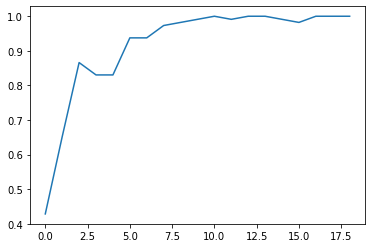

In [ ]:
plt.plot(acc_per_fold)

## Evaluate Model

In [ ]:
# evaluate accuracy on test data
test_loss, test_acc = model_final.evaluate(x_test, to_categorical(y_test), verbose=2)
print('\nTest accuracy:', test_acc,'Test loss:',test_loss)

4/4 - 3s - loss: 1.3857 - accuracy: 0.8100 - 3s/epoch - 803ms/step

Test accuracy: 0.8100000023841858 Test loss: 1.385744571685791


In [ ]:
prediction = model_final.predict(x_test)
y_pred_bool = np.argmax(prediction, axis=1)
y_test_bool = y_test

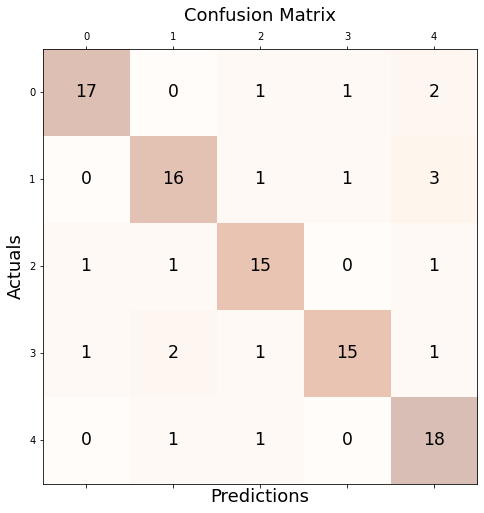

In [ ]:
#from sklearn.metrics.confusion_matrix import confusion_matrix
# showing the results 
conf_matrix = sklearn.metrics.confusion_matrix(y_pred=y_pred_bool , y_true=y_test_bool)
fig, ax = plt.subplots(figsize=(8, 8))
ax.matshow(conf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
for i in range(conf_matrix.shape[0]):
    for j in range(conf_matrix.shape[1]):
        ax.text(x=j, y=i,s=conf_matrix[i, j], va='center', ha='center', size='xx-large')
 
plt.xlabel('Predictions', fontsize=18)
plt.ylabel('Actuals', fontsize=18)
plt.title('Confusion Matrix', fontsize=18)
plt.show()

In [ ]:
print(classification_report(y_test_bool, y_pred_bool))

              precision    recall  f1-score   support

           0       0.89      0.81      0.85        21
           1       0.80      0.76      0.78        21
           2       0.79      0.83      0.81        18
           3       0.88      0.75      0.81        20
           4       0.72      0.90      0.80        20

    accuracy                           0.81       100
   macro avg       0.82      0.81      0.81       100
weighted avg       0.82      0.81      0.81       100



# Model 5) Resnet

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import Dense, Activation,Dropout,Conv2D, MaxPooling2D,BatchNormalization, Flatten
from tensorflow.keras.optimizers import Adamax
from tensorflow.keras.metrics import categorical_crossentropy
from tensorflow.keras import regularizers
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras import layers
from keras.utils.vis_utils import plot_model
import numpy as np
import pandas as pd
import shutil
import time
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow
import os
import seaborn as sns
sns.set_style('darkgrid')
from sklearn.metrics import confusion_matrix, classification_report

## read data

(511, 511, 4)


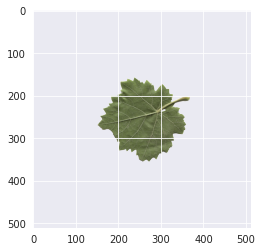

In [ ]:
fpath=r'/content/Grapevine_Leaves_Image_Dataset/Ak/Ak (1).png'
img=plt.imread(fpath)
print (img.shape)
imshow(img)

In [ ]:
sdir=r'/content/Grapevine_Leaves_Image_Dataset'
classlist=os.listdir(sdir)    
filepaths=[]
labels=[]    
for sinif in classlist:
    if sinif != 'grapevine-leaves-image-dataset':
        classpath=os.path.join(sdir,sinif)
        if os.path.isdir(classpath):
            flist=os.listdir(classpath)        
            for f in flist:
                fpath=os.path.join(classpath,f)        
                filepaths.append(fpath)
                labels.append(sinif)
Fseries=pd.Series(filepaths, name='filepaths')
Lseries=pd.Series(labels, name='labels')    
df=pd.concat([Fseries, Lseries], axis=1)    
print (df.head())
print('df length: ', len(df))
print (df['labels'].value_counts())

                                           filepaths labels
0  /content/Grapevine_Leaves_Image_Dataset/Ak/Ak ...     Ak
1  /content/Grapevine_Leaves_Image_Dataset/Ak/Ak ...     Ak
2  /content/Grapevine_Leaves_Image_Dataset/Ak/Ak ...     Ak
3  /content/Grapevine_Leaves_Image_Dataset/Ak/Ak ...     Ak
4  /content/Grapevine_Leaves_Image_Dataset/Ak/Ak ...     Ak
df length:  500
Ak           100
Dimnit       100
Nazli        100
Ala_Idris    100
Buzgulu      100
Name: labels, dtype: int64


In [ ]:
sample_list=[]
max_size= 100
groups=df.groupby('labels')
for label in df['labels'].unique():                 
    group=groups.get_group(label)
    sample_count=len(group)    
    if sample_count> max_size:
        samples=group.sample(max_size, replace=False, weights=None, random_state=123, axis=0).reset_index(drop=True)
    else:
        samples=group.sample(frac=1.0, replace=False, random_state=123, axis=0).reset_index(drop=True)
    sample_list.append(samples)
df=pd.concat(sample_list, axis=0).reset_index(drop=True)
print (len(df))     
print (df['labels'].value_counts())

500
Ak           100
Dimnit       100
Nazli        100
Ala_Idris    100
Buzgulu      100
Name: labels, dtype: int64


In [ ]:
working_dir=r'./'
aug_dir=os.path.join(working_dir, 'aug')
if os.path.isdir(aug_dir):
    shutil.rmtree(aug_dir)
os.mkdir(aug_dir)
for label in df['labels'].unique():
    dir_path=os.path.join(aug_dir,label)    
    os.mkdir(dir_path)
print(os.listdir(aug_dir))

['Ak', 'Dimnit', 'Nazli', 'Ala_Idris', 'Buzgulu']


In [ ]:
target=300 
gen=ImageDataGenerator(horizontal_flip=True,  rotation_range=20, width_shift_range=.2,
                              height_shift_range=.2, zoom_range=.2)
groups=df.groupby('labels')
for label in df['labels'].unique():               
    group=groups.get_group(label)  
    sample_count=len(group)     
    if sample_count< target: 
        aug_img_count=0
        delta=target-sample_count 
        target_dir=os.path.join(aug_dir, label)    
        aug_gen=gen.flow_from_dataframe( group,  x_col='filepaths', y_col=None, target_size=(66,66), class_mode=None,
                                        batch_size=1, shuffle=False, save_to_dir=target_dir, save_prefix='aug-',
                                        save_format='jpg')
        while aug_img_count<delta:
            images=next(aug_gen)            
            aug_img_count += len(images)

Found 100 validated image filenames.
Found 100 validated image filenames.
Found 100 validated image filenames.
Found 100 validated image filenames.
Found 100 validated image filenames.


In [ ]:
aug=r'./aug'
auglist=os.listdir(aug)
print (auglist)
for sinif in auglist:
    classpath=os.path.join(aug, sinif)
    flist=os.listdir(classpath)
    print('sınıf: ', sinif, '  file count: ', len(flist))

['Ak', 'Dimnit', 'Nazli', 'Ala_Idris', 'Buzgulu']
sınıf:  Ak   file count:  200
sınıf:  Dimnit   file count:  200
sınıf:  Nazli   file count:  200
sınıf:  Ala_Idris   file count:  200
sınıf:  Buzgulu   file count:  200


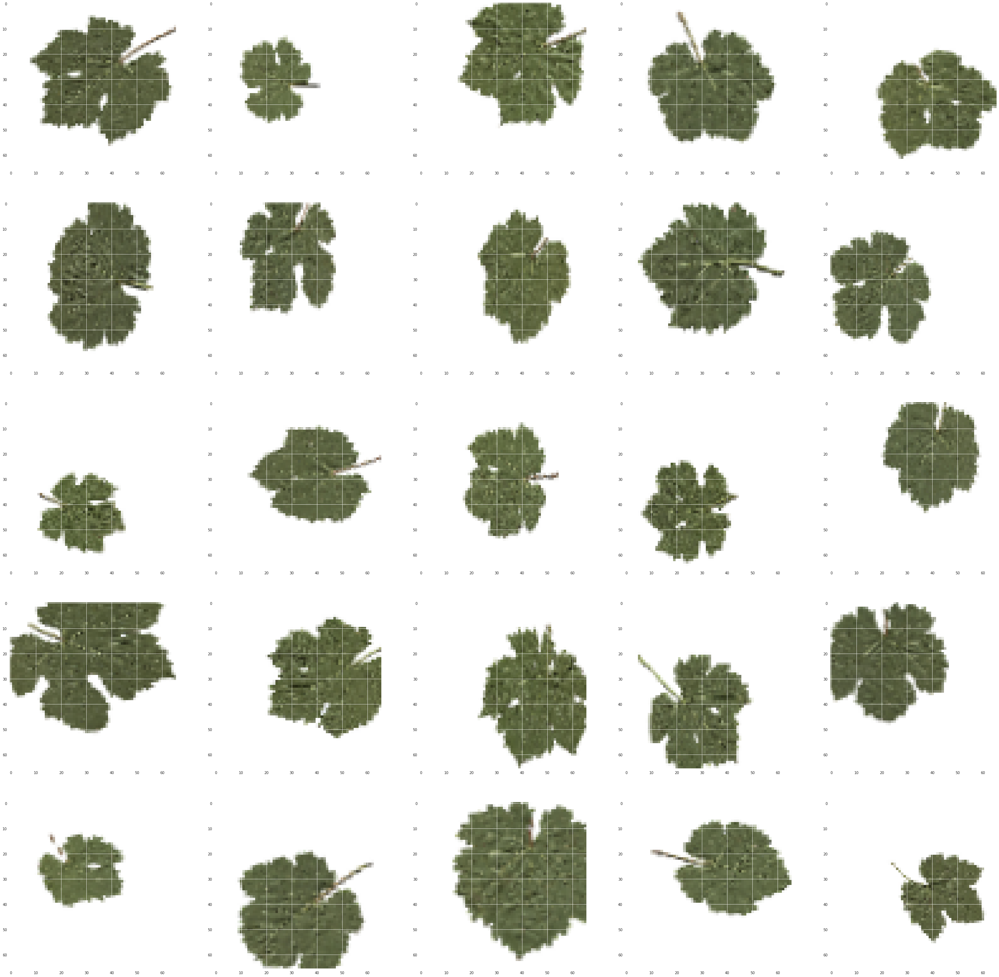

In [ ]:
plt.figure(figsize=(50, 50))
for i in range(25):
    image=next(aug_gen)/255
    image=np.squeeze(image, axis=0)
    plt.subplot(5,5,i+1)
    plt.imshow(image)
plt.show()

In [ ]:
aug_fpaths=[]
aug_labels=[]
classlist=os.listdir(aug_dir)
for sinif in classlist:
    classpath=os.path.join(aug_dir, sinif)     
    flist=os.listdir(classpath)    
    for f in flist:        
        fpath=os.path.join(classpath,f)         
        aug_fpaths.append(fpath)
        aug_labels.append(sinif)
Fseries=pd.Series(aug_fpaths, name='filepaths')
Lseries=pd.Series(aug_labels, name='labels')
aug_df=pd.concat([Fseries, Lseries], axis=1)
ndf=pd.concat([df,aug_df], axis=0).reset_index(drop=True)


print (df['labels'].value_counts()) 
print(aug_df['labels'].value_counts())
print (ndf['labels'].value_counts())

Ak           100
Dimnit       100
Nazli        100
Ala_Idris    100
Buzgulu      100
Name: labels, dtype: int64
Buzgulu      225
Ak           200
Dimnit       200
Nazli        200
Ala_Idris    200
Name: labels, dtype: int64
Buzgulu      325
Ak           300
Dimnit       300
Nazli        300
Ala_Idris    300
Name: labels, dtype: int64


In [ ]:
train_split=.8
valid_split=.1
dummy_split=valid_split/(1-train_split)
train_df, dummy_df=train_test_split(ndf, train_size=train_split, shuffle=True, random_state=123)
valid_df, test_df=train_test_split(dummy_df, train_size=dummy_split, shuffle=True, random_state=123)
print ('train_df length: ', len(train_df),'  test_df length: ', len(test_df), '  valid_df length: ', len(valid_df))

train_df length:  1220   test_df length:  153   valid_df length:  152


In [ ]:
height=60
width=60
channels=3
batch_size=40
img_shape=(height, width, channels)
img_size=(height, width)
length=len(test_df)
test_batch_size=sorted([int(length/n) for n in range(1,length+1) if length % n ==0 and length/n<=80],reverse=True)[0]  
test_steps=int(length/test_batch_size)
print ( 'test batch size: ' ,test_batch_size, '  test steps: ', test_steps)
def scalar(img):
    return img 
trgen=ImageDataGenerator(preprocessing_function=scalar, horizontal_flip=True)
tvgen=ImageDataGenerator(preprocessing_function=scalar)
sdir=r'../input/grapesImages/Image/images'
train_gen=trgen.flow_from_dataframe( train_df, x_col='filepaths', y_col='labels', target_size=img_size, class_mode='categorical',
                                    color_mode='rgb', shuffle=True, batch_size=batch_size)
test_gen=tvgen.flow_from_dataframe( test_df, x_col='filepaths', y_col='labels', target_size=img_size, class_mode='categorical',
                                    color_mode='rgb', shuffle=False, batch_size=test_batch_size)
valid_gen=tvgen.flow_from_dataframe( valid_df, x_col='filepaths', y_col='labels', target_size=img_size, class_mode='categorical',
                                    color_mode='rgb', shuffle=True, batch_size=batch_size)
classes=list(train_gen.class_indices.keys())
class_count=len(classes)
train_steps=int(len(train_gen.labels)/batch_size)

test batch size:  51   test steps:  3
Found 1220 validated image filenames belonging to 5 classes.
Found 153 validated image filenames belonging to 5 classes.
Found 152 validated image filenames belonging to 5 classes.


In [ ]:
def show_image_samples(gen ):
    t_dict=gen.class_indices
    classes=list(t_dict.keys())    
    images,labels=next(gen)
    plt.figure(figsize=(20, 20))
    length=len(labels)
    if length<25:
        r=length
    else:
        r=25
    for i in range(r):
        plt.subplot(5, 5, i + 1)
        image=images[i]/255
        plt.imshow(image)
        index=np.argmax(labels[i])
        class_name=classes[index]
        plt.title(class_name, color='blue', fontsize=16)
        plt.axis('off')
    plt.show()

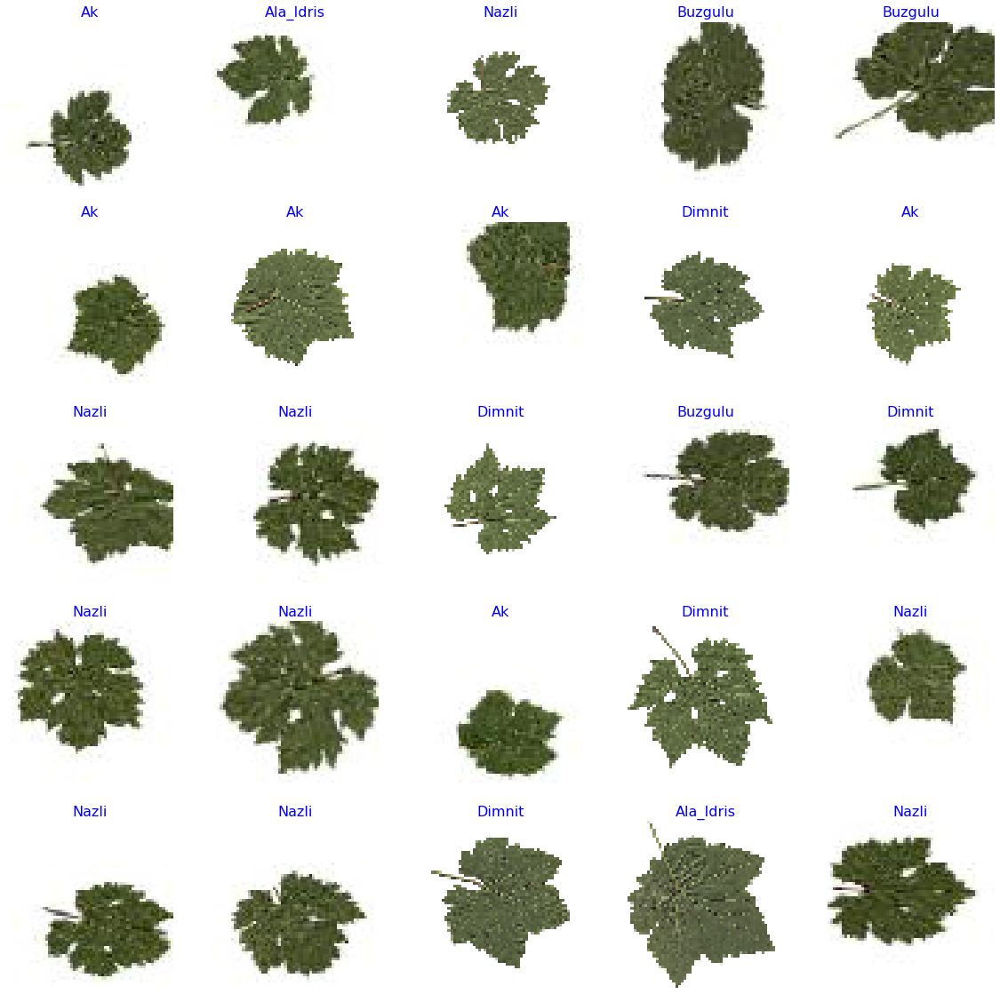

In [ ]:
show_image_samples(train_gen)

In [ ]:
def print_in_color(txt_msg,fore_tupple,back_tupple,):
    rf,gf,bf=fore_tupple
    rb,gb,bb=back_tupple
    msg='{0}' + txt_msg
    mat='\33[38;2;' + str(rf) +';' + str(gf) + ';' + str(bf) + ';48;2;' + str(rb) + ';' +str(gb) + ';' + str(bb) +'m' 
    print(msg .format(mat), flush=True)
    print('\33[0m', flush=True)
    return

## define model

In [ ]:
model_name='ResNet101V2'
basemodel = tf.keras.applications.ResNet101V2(weights = "imagenet",input_shape = img_shape,include_top=False,pooling='max')
x=basemodel.output
x=keras.layers.BatchNormalization(axis=-1, momentum=0.99, epsilon=0.001 )(x)
x = Dense(256, kernel_regularizer = regularizers.l2(l = 0.02),activity_regularizer=regularizers.l1(0.005),
                bias_regularizer=regularizers.l1(0.006) ,activation='relu')(x)
x=Dropout(rate=.5, seed=123)(x)        
output = Dense(class_count, activation="softmax")(x)
model = tf.keras.Model(inputs = basemodel.inputs, outputs = output)
model.compile(Adamax(learning_rate=.001), loss='categorical_crossentropy', metrics=['accuracy']) 
model.summary()
plot_model(model, to_file='ResNet101V2_model_plot.png', show_shapes=True, show_layer_names=True)

171327488/171317808 [==============================] - 4s 0us/step
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 60, 60, 3)]  0           []                               
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 66, 66, 3)    0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 30, 30, 64)   9472        ['conv1_pad[0][0]']              
                                                                                                  
 pool1_pad (ZeroPadding2D)      (None, 32, 32, 64)   0           ['conv1_conv[0][0]']             
                           

(60, 60, 3)
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 59, 59, 32)        416       
                                                                 
 conv2d_1 (Conv2D)           (None, 58, 58, 64)        8256      
                                                                 
 conv2d_2 (Conv2D)           (None, 57, 57, 64)        16448     
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 28, 28, 64)       0         
 2D)                                                             
                                                                 
 conv2d_3 (Conv2D)           (None, 27, 27, 128)       32896     
                                                                 
 conv2d_4 (Conv2D)           (None, 26, 26, 128)       65664     
                                            

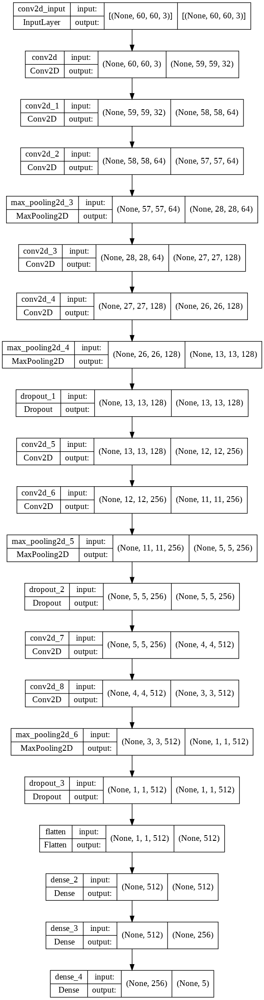

In [ ]:
print(img_shape)
model_name_own='OwnCNN'
model_own = Sequential()
model_own.add(keras.layers.Conv2D(32, kernel_size=(2, 2),
                 activation='relu',
                 input_shape=img_shape))
model_own.add(keras.layers.Conv2D(64, (2, 2)))
model_own.add(keras.layers.Conv2D(64, (2, 2), activation='relu'))
model_own.add(keras.layers.MaxPooling2D(pool_size=(2, 2)))
model_own.add(keras.layers.Conv2D(128, (2, 2)))
model_own.add(keras.layers.Conv2D(128, (2, 2), activation='relu'))
model_own.add(keras.layers.MaxPooling2D(pool_size=(2, 2)))
model_own.add(keras.layers.Dropout(0.15))
model_own.add(keras.layers.Conv2D(256, (2, 2)))
model_own.add(keras.layers.Conv2D(256, (2, 2), activation='relu'))
model_own.add(keras.layers.MaxPooling2D(pool_size=(2, 2)))
model_own.add(keras.layers.Dropout(0.25))
model_own.add(keras.layers.Conv2D(512, (2, 2)))
model_own.add(keras.layers.Conv2D(512, (2, 2), activation='relu'))
model_own.add(keras.layers.MaxPooling2D(pool_size=(2, 2)))
model_own.add(keras.layers.Dropout(0.2))
model_own.add(keras.layers.Flatten())
model_own.add(keras.layers.Dense(512, activation='relu'))
model_own.add(keras.layers.Dense(256, activation='relu'))
model_own.add(keras.layers.Dense(units=class_count, activation='softmax'))
model_own.compile(Adamax(learning_rate=.001), loss='categorical_crossentropy', metrics=['accuracy']) 
model_own.summary()
plot_model(model_own, to_file='OwnCNN_model_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
class LRA(keras.callbacks.Callback):
    reset=False
    count=0
    stop_count=0
    
    def __init__(self,model, patience,stop_patience, threshold, factor, model_name, freeze,batches, initial_epoch,epochs):
        super(LRA, self).__init__()
        self.epochs=epochs
        self.model=model
        self.patience=patience 
        self.stop_patience=stop_patience
        self.threshold=threshold 
        self.factor=factor 
        self.lr=float(tf.keras.backend.get_value(model.optimizer.lr)) 
        self.highest_tracc=0.0 
        self.lowest_vloss=np.inf 
        self.initial_epoch=initial_epoch 
        self.batches=batches
        best_weights=self.model.get_weights()         
        msg=' '
        if freeze==True:
            msgs=f' Starting training using  base model { model_name} with weights frozen to imagenet weights initializing LRA callback'
        else:
            msgs=f' Starting training using base model { model_name} training all layers '            
        print_in_color (msgs, (244, 252, 3), (55,65,80)) 
    def on_train_begin(self, logs=None):
        msg='{0:^8s}{1:^10s}{2:^9s}{3:^9s}{4:^9s}{5:^9s}{6:^9s}{7:^10s}{8:^8s}'.format('Epoch', 'Loss', 'Accuracy',
                                                                                              'V_loss','V_acc', 'LR', 'Next LR', 'Monitor', 'Duration')
        print_in_color(msg, (244,252,3), (55,65,80)) 
 

        
    def on_train_batch_end(self, batch, logs=None):
        acc=logs.get('accuracy')* 100  
        loss=logs.get('loss')
        msg='{0:20s}processing batch {1:4s} of {2:5s} accuracy= {3:8.3f}  loss: {4:8.5f}'.format(' ', str(batch), str(self.batches), acc, loss)
        print(msg, '\r', end='') 
        
        
    def on_epoch_begin(self,epoch, logs=None):
        self.now= time.time()
        
    def on_epoch_end(self, epoch, logs=None):  
        later=time.time()
        duration=later-self.now 
        lr=float(tf.keras.backend.get_value(self.model.optimizer.lr)) 
        current_lr=lr
        v_loss=logs.get('val_loss')  
        acc=logs.get('accuracy')  
        v_acc=logs.get('val_accuracy')
        loss=logs.get('loss')
        if acc < self.threshold: 
            monitor='accuracy'
            if acc>self.highest_tracc:                 
                self.highest_tracc=acc 
                LRA.best_weights=self.model.get_weights()
                self.count=0
                self.stop_count=0 
                if v_loss<self.lowest_vloss:
                    self.lowest_vloss=v_loss
                color= (0,255,0)
                self.lr=lr
            else: 
                if self.count>=self.patience -1:
                    color=(245, 170, 66)
                    self.lr= lr* self.factor 
                    tf.keras.backend.set_value(self.model.optimizer.lr, self.lr) 
                    self.count=0 
                    self.stop_count=self.stop_count + 1              
                                                      
                else:
                    self.count=self.count +1                    
        else: 
            monitor='val_loss'
            if v_loss< self.lowest_vloss: 
                self.lowest_vloss=v_loss           
                self.count=0 
                self.stop_count=0  
                color=(0,255,0)
                self.lr=lr
            else: 
                if self.count>=self.patience-1:
                    color=(245, 170, 66)
                    self.lr=self.lr * self.factor                
                    self.stop_count=self.stop_count + 1 
                    self.count=0 
                    tf.keras.backend.set_value(self.model.optimizer.lr, self.lr)  
                else: 
                    self.count =self.count +1               
                if acc>self.highest_tracc:
                    self.highest_tracc= acc
        msg=f'{str(epoch+1):^3s}/{str(self.epochs):4s} {loss:^9.3f}{acc*100:^9.3f}{v_loss:^9.5f}{v_acc*100:^9.3f}{current_lr:^9.5f}{self.lr:^9.5f}{monitor:^11s}{duration:^8.2f}'
        print_in_color (msg,color, (55,65,80))
        if self.stop_count> self.stop_patience - 1: 
            msg=f' training has been halted at epoch {epoch + 1} after {self.stop_patience} adjustments of learning rate with no improvement'
            print_in_color(msg, (0,255,255), (55,65,80))
            self.model.stop_training = True
        

## train model

In [ ]:
epochs =40
patience= 1 
stop_patience =4 
threshold=.9 
factor=.5  
freeze=False
batches=train_steps
callbacks_own=[LRA(model=model_own,patience=patience,stop_patience=stop_patience, threshold=threshold,
                   factor=factor, model_name=model_name_own, freeze=freeze, batches=batches,initial_epoch=0,epochs=epochs )]

history_own=model_own.fit(x=train_gen,  epochs=epochs, verbose=0, callbacks=callbacks_own,  validation_data=valid_gen,
               validation_steps=None,  shuffle=False,  initial_epoch=0)

 Starting training using base model OwnCNN training all layers 

 Epoch     Loss   Accuracy  V_loss    V_acc     LR     Next LR  Monitor  Duration

 1 /40     3.811   22.459   1.58663  26.316   0.00100  0.00100  accuracy   45.39  

 2 /40     1.614   21.803   1.61258  22.368   0.00100  0.00050  accuracy   41.94  

 3 /40     1.604   22.049   1.60834  18.421   0.00050  0.00025  accuracy   42.31  

 4 /40     1.596   23.115   1.60133  16.447   0.00025  0.00025  accuracy   41.33  

 5 /40     1.591   24.180   1.59419  20.395   0.00025  0.00025  accuracy   41.35  

 6 /40     1.585   25.492   1.58962  22.368   0.00025  0.00025  accuracy   42.05  

 7 /40     1.580   26.967   1.58266  23.684   0.00025  0.00025  accuracy   41.50  

 8 /40     1.565   28.689   1.59151  24.342   0.00025  0.00025  accuracy   42.40  

 9 /40     1.554   29.754   1.58562  23.026   0.00025  0.00025  accuracy   41.18  

10 /40     1.549   30.082   1.56005  26.974   0.00025  0.00025  accuracy   41.42  

11 /40     1

In [ ]:
callbacks=[LRA(model=model,patience=patience,stop_patience=stop_patience, threshold=threshold,
                   factor=factor, model_name=model_name, freeze=freeze, batches=batches,initial_epoch=0,epochs=epochs )]

history=model.fit(x=train_gen,  epochs=epochs, verbose=0, callbacks=callbacks,  validation_data=valid_gen,
               validation_steps=None,  shuffle=False,  initial_epoch=0)

 Starting training using base model ResNet101V2 training all layers 

 Epoch     Loss   Accuracy  V_loss    V_acc     LR     Next LR  Monitor  Duration

 1 /40    11.404   26.066  23.87474  19.079   0.00100  0.00100  accuracy   248.79 

 2 /40    10.081   33.033  20.97130  23.026   0.00100  0.00100  accuracy   234.18 

 3 /40     9.082   34.836  16.79381  23.684   0.00100  0.00100  accuracy   233.33 

 4 /40     8.374   35.984  12.78179  34.868   0.00100  0.00100  accuracy   239.30 

 5 /40     7.824   42.705  10.23644  40.789   0.00100  0.00100  accuracy   234.36 

 6 /40     7.285   50.984   8.47346  42.763   0.00100  0.00100  accuracy   232.73 

 7 /40     6.841   54.672   6.75594  54.605   0.00100  0.00100  accuracy   231.69 

 8 /40     6.438   57.131   6.81856  46.053   0.00100  0.00100  accuracy   232.28 

 9 /40     6.012   63.689   5.99079  51.974   0.00100  0.00100  accuracy   232.31 

10 /40     5.621   66.311   5.58421  60.526   0.00100  0.00100  accuracy   231.51 

11 /40 

In [ ]:
def tr_plot(tr_data, start_epoch):
    tacc=tr_data.history['accuracy']
    tloss=tr_data.history['loss']
    vacc=tr_data.history['val_accuracy']
    vloss=tr_data.history['val_loss']
    Epoch_count=len(tacc)+ start_epoch
    Epochs=[]
    for i in range (start_epoch ,Epoch_count):
        Epochs.append(i+1)   
    index_loss=np.argmin(vloss)
    val_lowest=vloss[index_loss]
    index_acc=np.argmax(vacc)
    acc_highest=vacc[index_acc]
    plt.style.use('fivethirtyeight')
    sc_label='best epoch= '+ str(index_loss+1 +start_epoch)
    vc_label='best epoch= '+ str(index_acc + 1+ start_epoch)
    fig,axes=plt.subplots(nrows=1, ncols=2, figsize=(20,8))
    axes[0].plot(Epochs,tloss, 'r', label='Training loss')
    axes[0].plot(Epochs,vloss,'g',label='Validation loss' )
    axes[0].scatter(index_loss+1 +start_epoch,val_lowest, s=150, c= 'blue', label=sc_label)
    axes[0].set_title('Training and Validation Loss')
    axes[0].set_xlabel('Epochs')
    axes[0].set_ylabel('Loss')
    axes[0].legend()
    axes[1].plot (Epochs,tacc,'r',label= 'Training Accuracy')
    axes[1].plot (Epochs,vacc,'g',label= 'Validation Accuracy')
    axes[1].scatter(index_acc+1 +start_epoch,acc_highest, s=150, c= 'blue', label=vc_label)
    axes[1].set_title('Training and Validation Accuracy')
    axes[1].set_xlabel('Epochs')
    axes[1].set_ylabel('Accuracy')
    axes[1].legend()
    plt.tight_layout
    plt.show()

In [ ]:
def print_info( test_gen, preds, print_code, save_dir, subject ):
    class_dict=test_gen.class_indices
    labels= test_gen.labels
    file_names= test_gen.filenames 
    error_list=[]
    true_class=[]
    pred_class=[]
    prob_list=[]
    new_dict={}
    error_indices=[]
    y_pred=[]
    for key,value in class_dict.items():
        new_dict[value]=key             
    classes=list(new_dict.values())   
    dict_as_text=str(new_dict)
    dict_name= subject + '-' +str(len(classes)) +'.txt'  
    dict_path=os.path.join(save_dir,dict_name)    
    with open(dict_path, 'w') as x_file:
        x_file.write(dict_as_text)    
    errors=0      
    for i, p in enumerate(preds):
        pred_index=np.argmax(p)        
        true_index=labels[i] 
        if pred_index != true_index: 
            error_list.append(file_names[i])
            true_class.append(new_dict[true_index])
            pred_class.append(new_dict[pred_index])
            prob_list.append(p[pred_index])
            error_indices.append(true_index)            
            errors=errors + 1
        y_pred.append(pred_index)    
    if print_code !=0:
        if errors>0:
            if print_code>errors:
                r=errors
            else:
                r=print_code           
            msg='{0:^28s}{1:^28s}{2:^28s}{3:^16s}'.format('Filename', 'Predicted Class' , 'True Class', 'Probability')
            print_in_color(msg, (0,255,0),(55,65,80))
            for i in range(r):                
                split1=os.path.split(error_list[i])                
                split2=os.path.split(split1[0])                
                fname=split2[1] + '/' + split1[1]
                msg='{0:^28s}{1:^28s}{2:^28s}{3:4s}{4:^6.4f}'.format(fname, pred_class[i],true_class[i], ' ', prob_list[i])
                print_in_color(msg, (255,255,255), (55,65,60))            
        else:
            msg='With accuracy of 100 % there are no errors to print'
            print_in_color(msg, (0,255,0),(55,65,80))
    if errors>0:
        plot_bar=[]
        plot_class=[]
        for  key, value in new_dict.items():        
            count=error_indices.count(key) 
            if count!=0:
                plot_bar.append(count) 
                plot_class.append(value) 
        fig=plt.figure()
        fig.set_figheight(len(plot_class)/3)
        fig.set_figwidth(10)
        plt.style.use('fivethirtyeight')
        for i in range(0, len(plot_class)):
            c=plot_class[i]
            x=plot_bar[i]
            plt.barh(c, x, )
            plt.title( ' Errors by Class on Test Set')
    y_true= np.array(labels)        
    y_pred=np.array(y_pred)
    if len(classes)<= 30:
        cm = confusion_matrix(y_true, y_pred )        
        length=len(classes)
        if length<8:
            fig_width=8
            fig_height=8
        else:
            fig_width= int(length * .5)
            fig_height= int(length * .5)
        plt.figure(figsize=(fig_width, fig_height))
        sns.heatmap(cm, annot=True, vmin=0, fmt='g', cmap='Blues', cbar=False)       
        plt.xticks(np.arange(length)+.5, classes, rotation= 90)
        plt.yticks(np.arange(length)+.5, classes, rotation=0)
        plt.xlabel("Predicted")
        plt.ylabel("Actual")
        plt.title("Confusion Matrix")
        plt.show()
    clr = classification_report(y_true, y_pred, target_names=classes)
    print("Classification Report:\n----------------------\n", clr)

## evaluate model

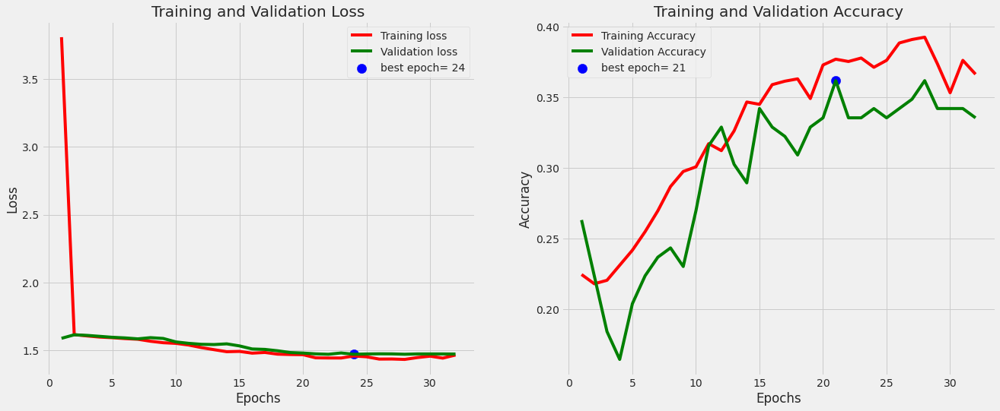

3/3 [==============================] - 1s 434ms/step - loss: 1.5243 - accuracy: 0.2549
accuracy on the test set is 25.49 %



In [ ]:
tr_plot(history_own,0)
save_dir=r'./'
subject='grapes'
acc=model_own.evaluate( test_gen, batch_size=test_batch_size, verbose=1, steps=test_steps, return_dict=False)[1]*100
msg=f'accuracy on the test set is {acc:5.2f} %'
print_in_color(msg, (0,255,0),(55,65,80))
save_id=str (model_name_own +  '-' + subject +'-'+ str(acc)[:str(acc).rfind('.')+3] + '.h5')
save_loc=os.path.join(save_dir, save_id)
model_own.save(save_loc)

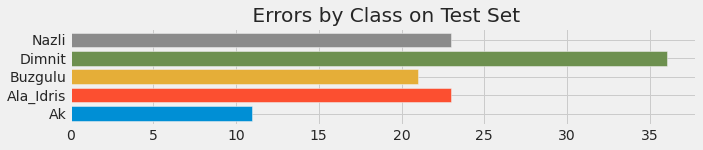

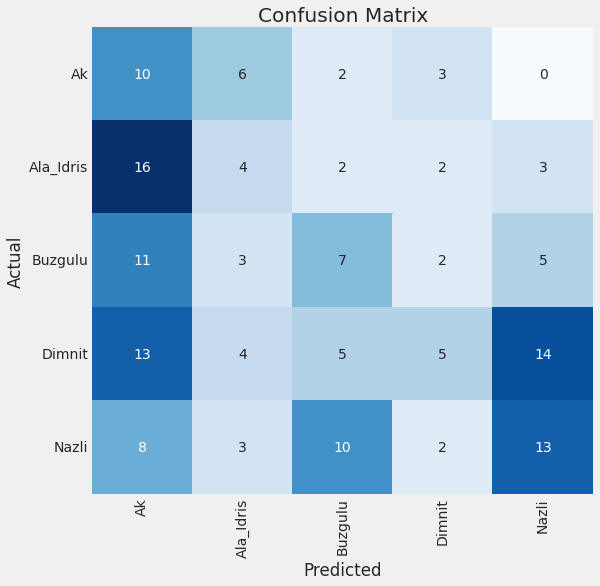

Classification Report:
----------------------
               precision    recall  f1-score   support

          Ak       0.17      0.48      0.25        21
   Ala_Idris       0.20      0.15      0.17        27
     Buzgulu       0.27      0.25      0.26        28
      Dimnit       0.36      0.12      0.18        41
       Nazli       0.37      0.36      0.37        36

    accuracy                           0.25       153
   macro avg       0.27      0.27      0.25       153
weighted avg       0.29      0.25      0.25       153



In [ ]:
print_code=0
preds=model_own.predict(test_gen) 
print_info( test_gen, preds, print_code, save_dir, subject )  

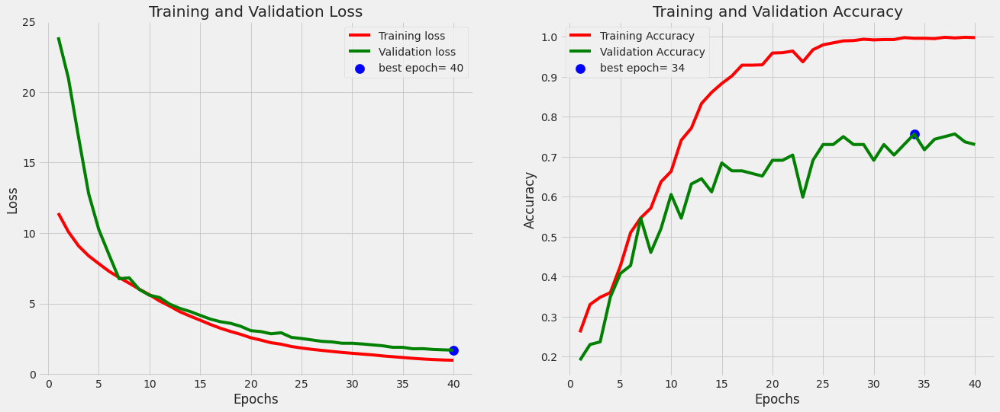

3/3 [==============================] - 3s 1s/step - loss: 1.6404 - accuracy: 0.7516
accuracy on the test set is 75.16 %



In [ ]:
tr_plot(history,0)
save_dir=r'./'
subject='grapes'
acc=model.evaluate( test_gen, batch_size=test_batch_size, verbose=1, steps=test_steps, return_dict=False)[1]*100
msg=f'accuracy on the test set is {acc:5.2f} %'
print_in_color(msg, (0,255,0),(55,65,80))
save_id=str (model_name +  '-' + subject +'-'+ str(acc)[:str(acc).rfind('.')+3] + '.h5')
save_loc=os.path.join(save_dir, save_id)
model.save(save_loc)

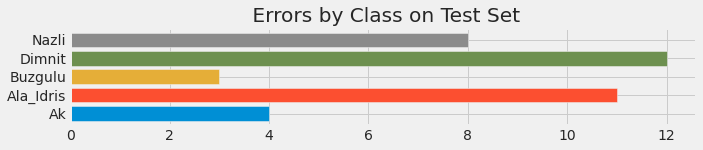

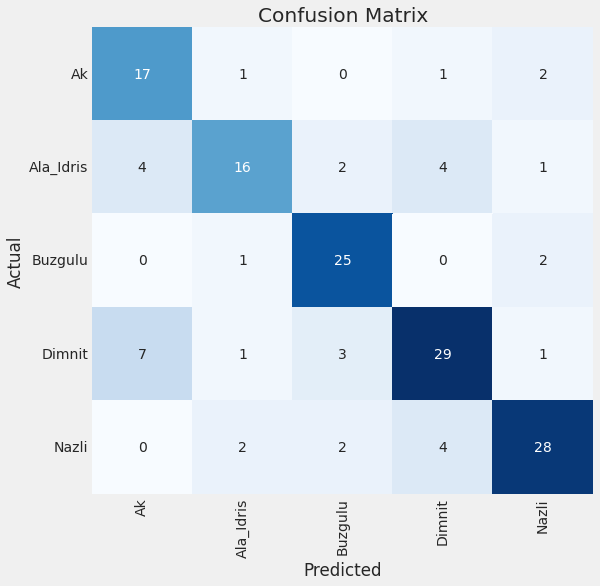

Classification Report:
----------------------
               precision    recall  f1-score   support

          Ak       0.61      0.81      0.69        21
   Ala_Idris       0.76      0.59      0.67        27
     Buzgulu       0.78      0.89      0.83        28
      Dimnit       0.76      0.71      0.73        41
       Nazli       0.82      0.78      0.80        36

    accuracy                           0.75       153
   macro avg       0.75      0.76      0.75       153
weighted avg       0.76      0.75      0.75       153



In [ ]:
print_code=0
preds=model.predict(test_gen) 
print_info( test_gen, preds, print_code, save_dir, subject )

# Model 6) InceptionV3_model

## read data

In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
import tensorflow as tf

In [ ]:
physical_devices = tf.config.list_physical_devices('GPU')
tf.config.experimental.set_memory_growth(physical_devices[0], enable=True)

In [ ]:
source_path = "/content/Grapevine_Leaves_Image_Dataset"
grape_labels = ['Ak', 'Ala_Idris', 'Buzgulu', 'Dimnit', 'Nazli']

for i in grape_labels:
    print(f"There are {len(os.listdir(os.path.join(source_path, i)))} images of", i)

There are 100 images of Ak
There are 100 images of Ala_Idris
There are 100 images of Buzgulu
There are 100 images of Dimnit
There are 100 images of Nazli


In [ ]:
root_dir = "./grape_dataset"

In [ ]:
def create_train_test_dirs(root_path):
    
    path = os.path.join(root_path, "training")
    os.makedirs(path)
    for i in grape_labels:
        os.makedirs(os.path.join(path,i))
    path = os.path.join(root_path, "testing")
    os.makedirs(path)
    for i in grape_labels:
        os.makedirs(os.path.join(path,i))
    path = os.path.join(root_path, "valid")
    os.makedirs(path)
    for i in grape_labels:
        os.makedirs(os.path.join(path,i))
    path = os.path.join(root_path, "training1")
    os.makedirs(path)
    for i in grape_labels:
        os.makedirs(os.path.join(path,i))

In [ ]:
create_train_test_dirs(root_dir)

In [ ]:
def split_data(SOURCE, TRAINING, TESTING, SPLIT_SIZE):

  files = []
  for filename in os.listdir(SOURCE):
    file = SOURCE + filename
    if os.path.getsize(file) > 0:
      files.append(filename)
    else:
      print(filename + ' is zero length, so ignoring.')
    
    import random
    from shutil import copyfile

    training_length = int(len(files) * SPLIT_SIZE)
    testing_length = int(len(files) - training_length)
    shuffled_set = random.sample(files, len(files))
    training_set = shuffled_set[0:training_length]
    testing_set = shuffled_set[-testing_length:]
  
  for filename in training_set:
    src_file = SOURCE + filename
    dest_file = TRAINING + filename
    copyfile(src_file, dest_file)
  for filename in testing_set:
    src_file = SOURCE + filename
    dest_file = TESTING + filename
    copyfile(src_file, dest_file)

In [ ]:
testing_dir = "./grape_dataset/testing"
training_dir1 = "./grape_dataset/training1"

split_size = 0.8

for i in grape_labels:
    label_source_dir1 = "/content/Grapevine_Leaves_Image_Dataset/" + str(i) + "/"
    training_label_dir1 = os.path.join(training_dir1, (str(i)+"/"))
    testing_label_dir = os.path.join(testing_dir, (str(i)+"/"))
    split_data(label_source_dir1, training_label_dir1, testing_label_dir, split_size)

In [ ]:
valid_dir = "./grape_dataset/valid"
training_dir = "./grape_dataset/training"

split_size = 0.8

for i in grape_labels:
    label_source_dir = "/content/grape_dataset/training1/" + str(i) + "/"
    training_label_dir = os.path.join(training_dir, (str(i)+"/"))
    valid_label_dir = os.path.join(valid_dir, (str(i)+"/"))
    split_data(label_source_dir, training_label_dir, valid_label_dir, split_size)

In [ ]:
for i in grape_labels:
    training_label_dir = os.path.join(training_dir, (str(i)+"/"))
    testing_label_dir = os.path.join(testing_dir, (str(i)+"/"))
    valid_label_dir = os.path.join(valid_dir, (str(i)+"/"))
    
    print(f"\n\nThere are {len(os.listdir(training_label_dir))} images of", i, "for training")
    print(f"\n\nThere are {len(os.listdir(testing_label_dir))} images of", i, "for testing")
    print(f"\n\nThere are {len(os.listdir(valid_label_dir))} images of", i, "for validation")



There are 64 images of Ak for training


There are 20 images of Ak for testing


There are 16 images of Ak for validation


There are 64 images of Ala_Idris for training


There are 20 images of Ala_Idris for testing


There are 16 images of Ala_Idris for validation


There are 64 images of Buzgulu for training


There are 20 images of Buzgulu for testing


There are 16 images of Buzgulu for validation


There are 64 images of Dimnit for training


There are 20 images of Dimnit for testing


There are 16 images of Dimnit for validation


There are 64 images of Nazli for training


There are 20 images of Nazli for testing


There are 16 images of Nazli for validation


In [ ]:
def train_val_generators(TRAINING_DIR, VALIDATION_DIR, TESTING_DIR):
  
  from tensorflow.keras.preprocessing.image import ImageDataGenerator
  
  train_datagen = ImageDataGenerator(rescale=1.0/255.,
                                     rotation_range=40,
                                     width_shift_range=0.2,
                                     height_shift_range=0.2,
                                     zoom_range=0.1,
                                     horizontal_flip=True,
                                     vertical_flip=True,
                                     fill_mode='nearest')

  # Pass in the appropriate arguments to the flow_from_directory method
  train_generator = train_datagen.flow_from_directory(directory=TRAINING_DIR,
                                                      batch_size=100,
                                                      class_mode='categorical',
                                                      target_size=(300, 300))

  # Instantiate the ImageDataGenerator class (don't forget to set the rescale argument)
  validation_datagen = ImageDataGenerator(rescale=1.0/255.)
  # Pass in the appropriate arguments to the flow_from_directory method
  validation_generator = validation_datagen.flow_from_directory(directory=VALIDATION_DIR,
                                                                batch_size=50,
                                                                class_mode='categorical',
                                                                target_size=(300, 300))
  
  # Instantiate the ImageDataGenerator class (don't forget to set the rescale argument)
  test_datagen = ImageDataGenerator(rescale=1.0/255.)
  # Pass in the appropriate arguments to the flow_from_directory method
  test_generator = test_datagen.flow_from_directory(directory=TESTING_DIR,
                                                                batch_size=50,
                                                                class_mode='categorical',
                                                                target_size=(300, 300))
  ### END CODE HERE
  return train_generator, validation_generator, test_generator

In [ ]:
train_generator, validation_generator ,test_generator = train_val_generators(training_dir,valid_dir, testing_dir)

Found 320 images belonging to 5 classes.
Found 80 images belonging to 5 classes.
Found 100 images belonging to 5 classes.


## define model

In [ ]:
from tensorflow.keras import Sequential, layers
model = Sequential()
model.add(layers.Conv2D(filters=64, kernel_size=(2,2), kernel_initializer="he_uniform", input_shape=(300,300,3), activation="relu"))
model.add(layers.MaxPool2D((2,2)))
model.add(layers.Conv2D(filters=64, kernel_size=(2,2), kernel_initializer="he_uniform", activation="relu"))
model.add(layers.MaxPool2D((2,2)))
model.add(layers.Conv2D(filters=64, kernel_size=(2,2), kernel_initializer="he_uniform", activation="relu"))
model.add(layers.MaxPool2D((2,2)))
model.add(layers.Conv2D(filters=64, kernel_size=(2,2), kernel_initializer="he_uniform", activation="relu"))
model.add(layers.MaxPool2D((2,2)))
model.add(layers.Flatten())
model.add(layers.Dense(units=256, kernel_initializer="he_uniform", activation="relu"))
model.add(layers.Dense(units=512, kernel_initializer="he_uniform", activation="relu"))
model.add(layers.Dense(units=64, kernel_initializer="he_uniform", activation="relu"))
model.add(layers.Dense(units=5, kernel_initializer="glorot_uniform", activation="softmax"))

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 299, 299, 64)      832       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 149, 149, 64)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 148, 148, 64)      16448     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 74, 74, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 73, 73, 64)        16448     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 36, 36, 64)       0

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)
model.compile(
        optimizer=optimizer,
        loss="categorical_crossentropy",
        metrics=["accuracy"]
)

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.applications.inception_v3 import InceptionV3

In [ ]:
InceptionV3_model = tf.keras.applications.InceptionV3(weights='imagenet', include_top=False, input_shape=(300, 300, 3))

87924736/87910968 [==============================] - 2s 0us/step


In [ ]:
# The last 15 layers fine tune
for layer in InceptionV3_model.layers[:-15]:
    layer.trainable = False

x = InceptionV3_model.output
x = layers.GlobalAveragePooling2D()(x)
x = layers.Flatten()(x)
x = layers.Dense(units=512, activation='relu')(x)
x = layers.Dropout(0.3)(x)
x = layers.Dense(units=512, activation='relu')(x)
x = layers.Dropout(0.3)(x)
output  = layers.Dense(units=5, activation='softmax')(x)
model = Model(InceptionV3_model.input, output)
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 300, 300, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_4 (Conv2D)              (None, 149, 149, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 149, 149, 32  96         ['conv2d_4[0][0]']               
 alization)                     )                                                             

## train model

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)
model.compile(
        optimizer=optimizer,
        loss="categorical_crossentropy",
        metrics=["accuracy"])

In [ ]:
history = model.fit(train_generator, steps_per_epoch=4, epochs=25, validation_data=validation_generator, validation_steps=2)

Epoch 1/25
4/4 [==============================] - 32s 3s/step - loss: 1.8275 - accuracy: 0.2500 - val_loss: 1.4692 - val_accuracy: 0.3625
Epoch 2/25
4/4 [==============================] - 8s 2s/step - loss: 1.4661 - accuracy: 0.3063 - val_loss: 1.4079 - val_accuracy: 0.4500
Epoch 3/25
4/4 [==============================] - 8s 2s/step - loss: 1.2486 - accuracy: 0.4719 - val_loss: 1.0484 - val_accuracy: 0.6500
Epoch 4/25
4/4 [==============================] - 8s 2s/step - loss: 1.0441 - accuracy: 0.5594 - val_loss: 0.9819 - val_accuracy: 0.6875
Epoch 5/25
4/4 [==============================] - 8s 3s/step - loss: 0.8603 - accuracy: 0.6844 - val_loss: 0.7409 - val_accuracy: 0.8125
Epoch 6/25
4/4 [==============================] - 8s 2s/step - loss: 0.7901 - accuracy: 0.6781 - val_loss: 0.7268 - val_accuracy: 0.7625
Epoch 7/25
4/4 [==============================] - 8s 2s/step - loss: 0.7138 - accuracy: 0.7281 - val_loss: 0.5899 - val_accuracy: 0.8625
Epoch 8/25
4/4 [========================

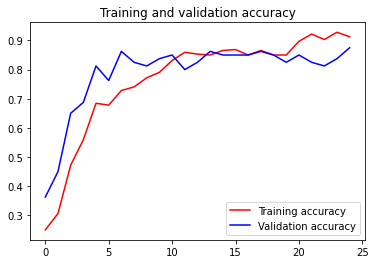

<Figure size 432x288 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt

acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

epochs = range(len(acc))

plt.plot(epochs, acc, 'r', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend(loc=0)
plt.figure()

plt.show()

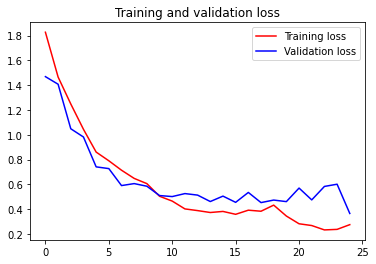

<Figure size 432x288 with 0 Axes>

In [ ]:
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(loss))

plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend(loc=0)
plt.figure()

plt.show()

## Evaluate inception module v1 Model

In [ ]:
# evaluate accuracy on test data
test_loss, test_acc = model.evaluate(test_generator, verbose=2)
print('\nTest accuracy:', test_acc,'Test loss:',test_loss)


Test accuracy: 0.9009999952316284 Test loss: 1.8780020475387573


In [ ]:
prediction = model.predict_generator(test_generator)
y_pred = prediction
y_pred_bool = np.argmax(y_pred, axis=1)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  """Entry point for launching an IPython kernel.


In [ ]:
y_pred_bool

array([2, 3, 4, 3, 3, 3, 1, 4, 3, 4, 2, 4, 1, 1, 1, 3, 2, 2, 4, 4, 2, 1,
       0, 3, 1, 0, 3, 0, 4, 2, 2, 1, 2, 3, 0, 3, 4, 2, 0, 3, 2, 0, 1, 1,
       1, 2, 1, 4, 2, 1, 3, 2, 0, 0, 2, 1, 2, 1, 4, 4, 0, 1, 2, 3, 1, 0,
       3, 1, 4, 4, 0, 4, 4, 4, 0, 3, 1, 0, 3, 4, 1, 2, 3, 0, 1, 4, 4, 4,
       0, 4, 1, 3, 1, 0, 0, 0, 1, 2, 2, 1])

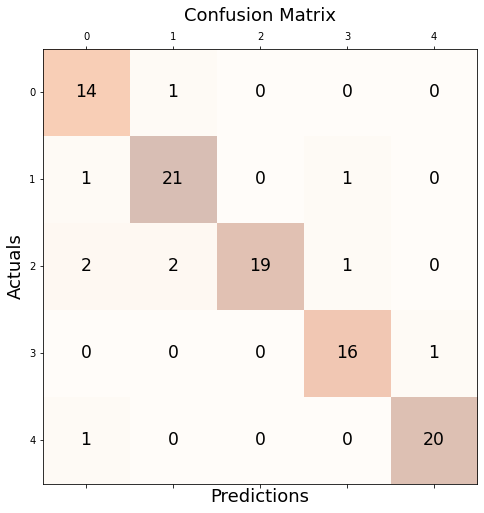

In [ ]:
#from sklearn.metrics.confusion_matrix import confusion_matrix
import sklearn
conf_matrix = sklearn.metrics.confusion_matrix(y_pred=y_pred_bool , y_true=y_test_bool)
fig, ax = plt.subplots(figsize=(8, 8))
ax.matshow(conf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
for i in range(conf_matrix.shape[0]):
    for j in range(conf_matrix.shape[1]):
        ax.text(x=j, y=i,s=conf_matrix[i, j], va='center', ha='center', size='xx-large')
 
plt.xlabel('Predictions', fontsize=18)
plt.ylabel('Actuals', fontsize=18)
plt.title('Confusion Matrix', fontsize=18)
plt.show()

In [ ]:
print(classification_report(y_test_bool, y_pred_bool))

              precision    recall  f1-score   support

           0       0.78      0.93      0.85        15
           1       0.88      0.91      0.89        23
           2       1.00      0.79      0.88        24
           3       0.89      0.94      0.91        17
           4       0.95      0.95      0.95        21

    accuracy                           0.90       100
   macro avg       0.90      0.91      0.90       100
weighted avg       0.91      0.90      0.90       100

